# Clustering

In this notebook we do the three types of clustering discussed 

In [1]:
import os
import pandas as pd
import matplotlib.pyplot as plt
from libraries.clustering import apply_pca, plot_results, apply_tsne
from libraries import clustering
from sklearn.cluster import KMeans, OPTICS, DBSCAN
from scipy.spatial.distance import squareform
from sklearn.cluster import DBSCAN
import numpy as np
from sklearn.cluster import SpectralClustering
from pyclustering.cluster.optics import optics, ordering_analyser
from libraries.clustering import sil_vs_coh
from sklearn.metrics import pairwise_distances

In [2]:
DATASET_DIR = "dataset" + os.sep
RESULTS_DIR = "results" + os.sep

In [3]:
# Load dataset with advanced anomaly detection already performed
merged_df = pd.read_csv(DATASET_DIR + "merge_clean_v2-AD.csv", parse_dates=["date"])
cyclist_df = pd.read_csv(DATASET_DIR + "cyclist_clean_v3.csv")
stages_df = pd.read_csv(DATASET_DIR + "stages_clean_v3.csv")

In [4]:
cyclist_df.info()
stages_df.info()
merged_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3020 entries, 0 to 3019
Data columns (total 6 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   Unnamed: 0  3020 non-null   int64  
 1   _url        3020 non-null   object 
 2   birth_year  3020 non-null   int64  
 3   height      3020 non-null   float64
 4   avg_pos     3020 non-null   float64
 5   num_races   3020 non-null   int64  
dtypes: float64(2), int64(3), object(1)
memory usage: 141.7+ KB
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2895 entries, 0 to 2894
Data columns (total 12 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   Unnamed: 0         2895 non-null   int64  
 1   _url               2895 non-null   object 
 2   points             2895 non-null   int64  
 3   length             2895 non-null   int64  
 4   climb_total        2895 non-null   int64  
 5   profile            2895 non-null   int64  
 6   startl

In [5]:
#cyclist_df.drop(columns=["name", "nationality", 'continent', "BMI"], inplace=True)
#stages_df.drop(columns=["stage", "date", "race"], inplace=True)

#cyclist_df.reset_index(drop=True, inplace=True)
#stages_df.reset_index(drop=True, inplace=True)

In [6]:
cyclist_df = cyclist_df.dropna()
stages_df = stages_df.dropna()

In [7]:
cyclist_df.info()
stages_df.info()
merged_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3020 entries, 0 to 3019
Data columns (total 6 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   Unnamed: 0  3020 non-null   int64  
 1   _url        3020 non-null   object 
 2   birth_year  3020 non-null   int64  
 3   height      3020 non-null   float64
 4   avg_pos     3020 non-null   float64
 5   num_races   3020 non-null   int64  
dtypes: float64(2), int64(3), object(1)
memory usage: 141.7+ KB
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2895 entries, 0 to 2894
Data columns (total 12 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   Unnamed: 0         2895 non-null   int64  
 1   _url               2895 non-null   object 
 2   points             2895 non-null   int64  
 3   length             2895 non-null   int64  
 4   climb_total        2895 non-null   int64  
 5   profile            2895 non-null   int64  
 6   startl

In [8]:
# List of categorical columns for transformation in the 'cyclist_df' DataFrame.
# These columns will not be transformed since we are leaving them as categorical features.
cat_cyclist = []

# List of columns to standardize in the 'cyclist_df' DataFrame.
# These columns will be standardized (i.e., scaled to have mean 0 and standard deviation 1).
stand_cyclist = ["height", "birth_year", 'avg_pos', 'num_races']

# List of columns to apply MinMax scaling in the 'cyclist_df' DataFrame.
# In this case, there are no columns specified for MinMax scaling.
minmax_cyclist = []

# Apply the transformation to the 'cyclist_df' DataFrame using the 'clustering.transform' method.
# It applies standardization, MinMax scaling, and encoding for categorical columns (if any).
# The result is the transformed data and the preprocessor (which holds information about how the data was transformed).
transformed_cyclists_data, preprocessor_cyclists = clustering.transform(
    cyclist_df,
    categorical_cols=cat_cyclist,
    standardize_cols=stand_cyclist,
    minmax_cols=minmax_cyclist,
)

# List of categorical columns for transformation in the 'stages_df' DataFrame.
# These columns are not specified here, as no categorical columns are being transformed.
cat_stage = []

# List of columns to standardize in the 'stages_df' DataFrame.
# These columns will be standardized (i.e., scaled to have mean 0 and standard deviation 1).
stand_stage = ["year", "length", "startlist_quality", 'avg_age_by_url', 'avg_delta_by_url', 'min_age_by_url', 'points']

# List of columns to apply MinMax scaling in the 'stages_df' DataFrame.
# Again, no columns are specified for MinMax scaling.
minmax_stage = []

# Apply the transformation to the 'stages_df' DataFrame using the 'clustering.transform' method.
# This applies standardization, MinMax scaling, and encoding for categorical columns (if any).
transformed_stages_data, preprocessor_stages = clustering.transform(
    stages_df,
    categorical_cols=cat_stage,
    minmax_cols=minmax_stage,
    standardize_cols=stand_stage
)

# Convert the transformed data for cyclists into a DataFrame.
# The transformed data now contains the processed values based on the specified transformations.
transformed_cyclists_df = pd.DataFrame(transformed_cyclists_data)

# Convert the transformed data for stages into a DataFrame.
# Similarly, the transformed stage data is now structured into a DataFrame.
transformed_stages_df = pd.DataFrame(transformed_stages_data)

# Add back the one-hot encoded columns' names to the transformed DataFrame for cyclists.
# This ensures that the transformed DataFrame has appropriate column names reflecting the transformations applied.
transformed_cyclists_df.columns = preprocessor_cyclists.get_feature_names_out(
    cyclist_df.columns
)

# Add back the one-hot encoded columns' names to the transformed DataFrame for stages.
# This ensures that the transformed DataFrame for stages has appropriate column names.
transformed_stages_df.columns = preprocessor_stages.get_feature_names_out(
    stages_df.columns
)

# Reset the index of the transformed cyclists DataFrame to ensure that indices are continuous after transformation.
transformed_cyclists_df.reset_index(drop=True, inplace=True)

# Reset the index of the transformed stages DataFrame in the same way to ensure continuous indices.
transformed_stages_df.reset_index(drop=True, inplace=True)

# Add the '_url' column back to the transformed cyclists DataFrame.
# The '_url' column is kept from the original 'cyclist_df' DataFrame for reference.
transformed_cyclists_df["_url"] = cyclist_df["_url"]

# Add the '_url' column back to the transformed stages DataFrame for reference.
transformed_stages_df["_url"] = stages_df["_url"]

# Drop the '_url' column from the transformed cyclists DataFrame as it's no longer needed after adding it back.
transformed_cyclists_df.drop(columns=["_url"], inplace=True)

# Drop the '_url' column from the transformed stages DataFrame similarly.
transformed_stages_df.drop(columns=["_url"], inplace=True)

In [9]:
transformed_cyclists_df.info()
transformed_stages_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3020 entries, 0 to 3019
Data columns (total 4 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   standardize__height      3020 non-null   float64
 1   standardize__birth_year  3020 non-null   float64
 2   standardize__avg_pos     3020 non-null   float64
 3   standardize__num_races   3020 non-null   float64
dtypes: float64(4)
memory usage: 94.5 KB
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2895 entries, 0 to 2894
Data columns (total 7 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   standardize__year               2895 non-null   float64
 1   standardize__length             2895 non-null   float64
 2   standardize__startlist_quality  2895 non-null   float64
 3   standardize__avg_age_by_url     2895 non-null   float64
 4   standardize__avg_delta_by_url   2895 non-null   floa

Create a version of the dataframes without categorical columns

In [10]:
def filter_one_hot_columns(df):
    return df.loc[:, ~df.columns.str.startswith("cat__")]


real_cyclists_df = filter_one_hot_columns(transformed_cyclists_df)
real_stages_df = filter_one_hot_columns(transformed_stages_df)

real_cyclists_df.info()
real_stages_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3020 entries, 0 to 3019
Data columns (total 4 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   standardize__height      3020 non-null   float64
 1   standardize__birth_year  3020 non-null   float64
 2   standardize__avg_pos     3020 non-null   float64
 3   standardize__num_races   3020 non-null   float64
dtypes: float64(4)
memory usage: 94.5 KB
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2895 entries, 0 to 2894
Data columns (total 7 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   standardize__year               2895 non-null   float64
 1   standardize__length             2895 non-null   float64
 2   standardize__startlist_quality  2895 non-null   float64
 3   standardize__avg_age_by_url     2895 non-null   float64
 4   standardize__avg_delta_by_url   2895 non-null   floa

In [11]:
cyclists = clustering.inverse_transform(transformed_cyclists_data, preprocessor_cyclists,
                                                      minmax_cols=minmax_cyclist,
                                                      standardize_cols=stand_cyclist,
                                                      categorical_cols=cat_cyclist)
stages = clustering.inverse_transform(transformed_stages_data, preprocessor_stages,
                                                      standardize_cols=stand_stage,
                                                      minmax_cols=minmax_stage,
                                                      categorical_cols=cat_stage)

## K-means

### K-Means cyclists

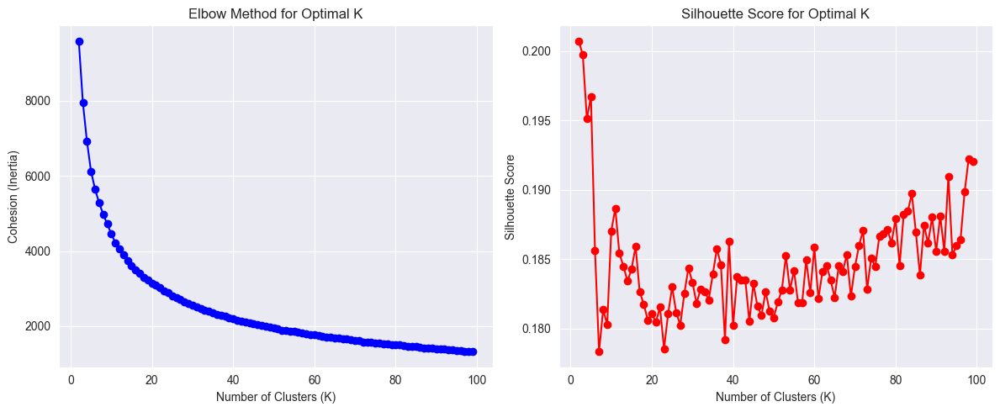

In [12]:
kmeans_list = clustering.plot_scores(real_cyclists_df)

In [13]:
kmeans = kmeans_list[9]
centers = clustering.inverse_transform(kmeans.cluster_centers_, preprocessor_cyclists,
                                                      minmax_cols=minmax_cyclist,
                                                      standardize_cols=stand_cyclist,
                                                      categorical_cols=cat_cyclist)
#clustering.optimal_pair_plot(cyclists, 'KCluster', kmeans.labels_)

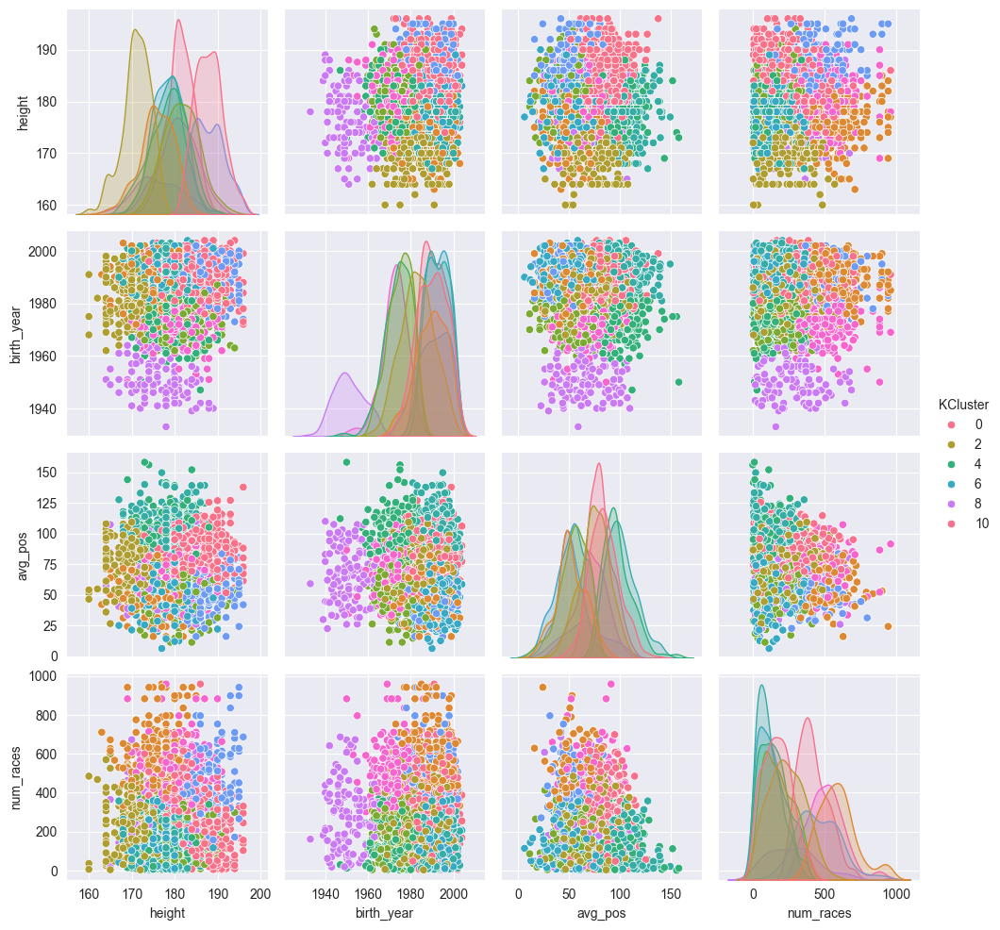

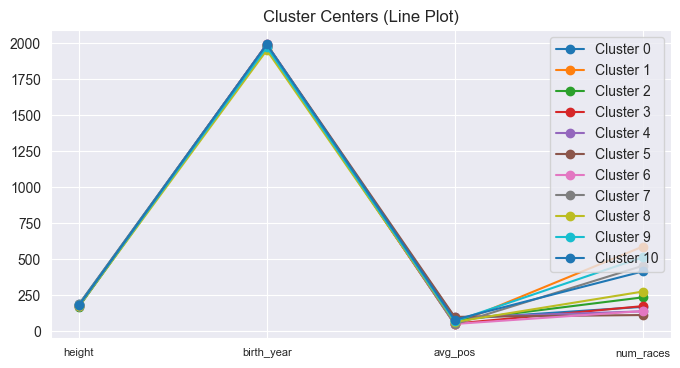

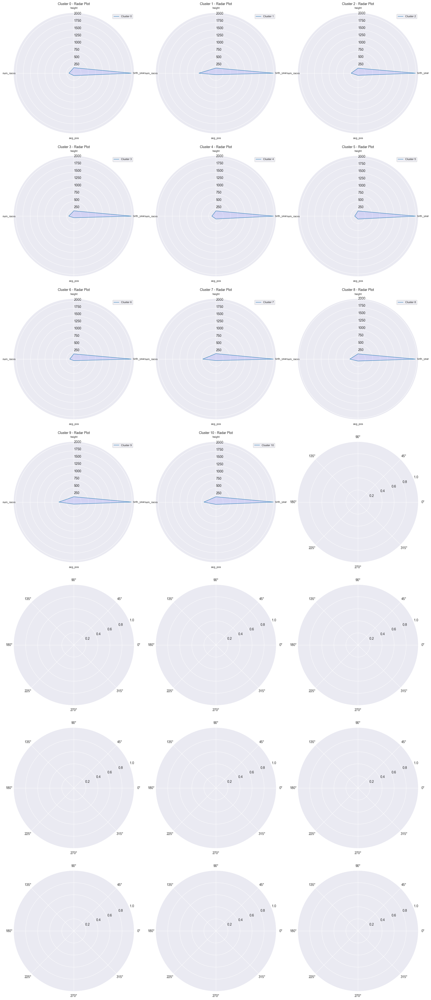

        height   birth_year     avg_pos   num_races
0   187.937952  1989.891566   85.030018  170.774096
1   175.784677  1989.451613   52.060045  588.383065
2   171.035294  1983.085294   74.734968  236.576471
3   181.605634  1975.105634   54.511160  175.820423
4   179.153265  1974.061856   97.602936  139.628866
5   177.816667  1992.700000  101.414491  114.170000
6   178.564331  1992.238854   52.098852  141.576433
7   187.917808  1990.360731   50.362111  455.200913
8   176.314050  1951.223140   66.015241  276.735537
9   180.795868  1972.338843   71.379115  514.413223
10  181.202432  1991.197568   81.365742  416.386018
height          4.993072
birth_year     12.821432
avg_pos        18.403650
num_races     169.810047
dtype: float64


In [14]:
clustering.optimal_pair_plot(cyclists, 'KCluster', kmeans.labels_)
clustering.plot_centers(cyclists, centers, 7, 3)
print(centers)
print(centers.std().sort_values())

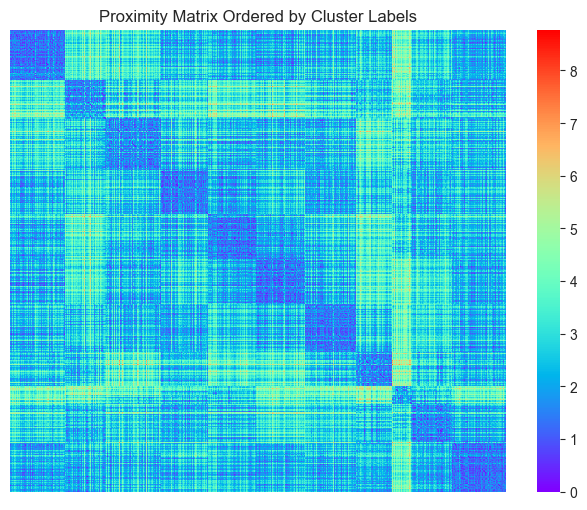

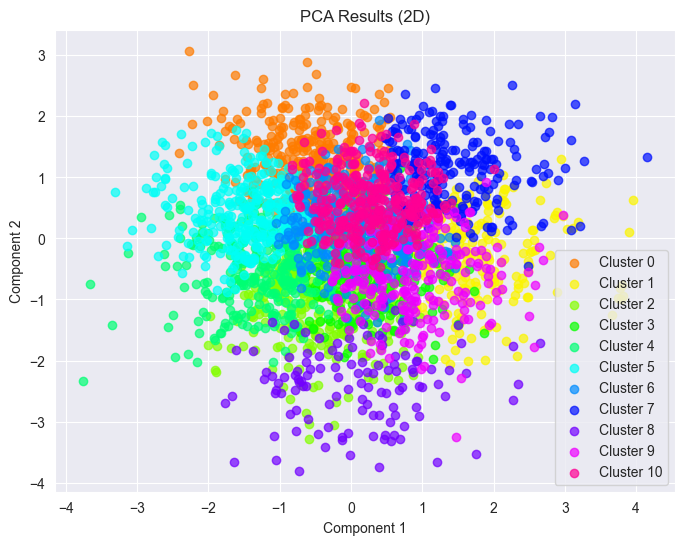

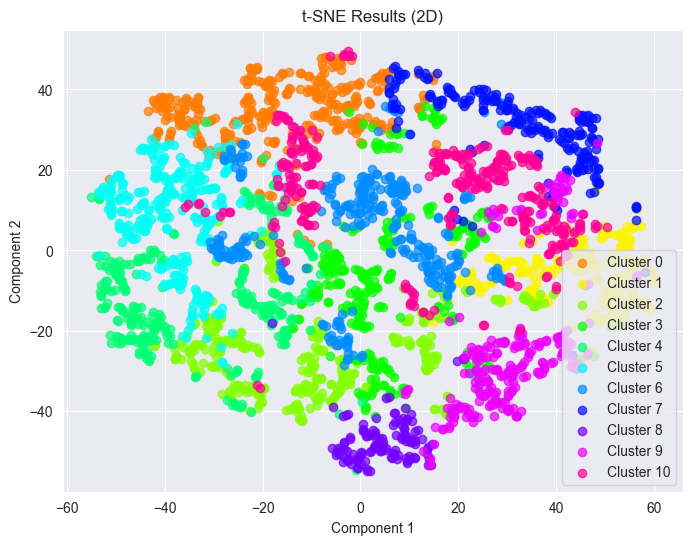

In [15]:
data_scaled = real_cyclists_df
labels = kmeans.labels_

clustering.similarity_matrix(real_cyclists_df, labels)

# 2D PCA
pca_2d = apply_pca(data_scaled, dimensions=2)
plot_results(pca_2d, labels, title="PCA Results (2D)", dimensions=2)

# 2D t-SNE
tsne_2d = apply_tsne(data_scaled, dimensions=2)
plot_results(tsne_2d, labels, title="t-SNE Results (2D)", dimensions=2)

### K-Means stages

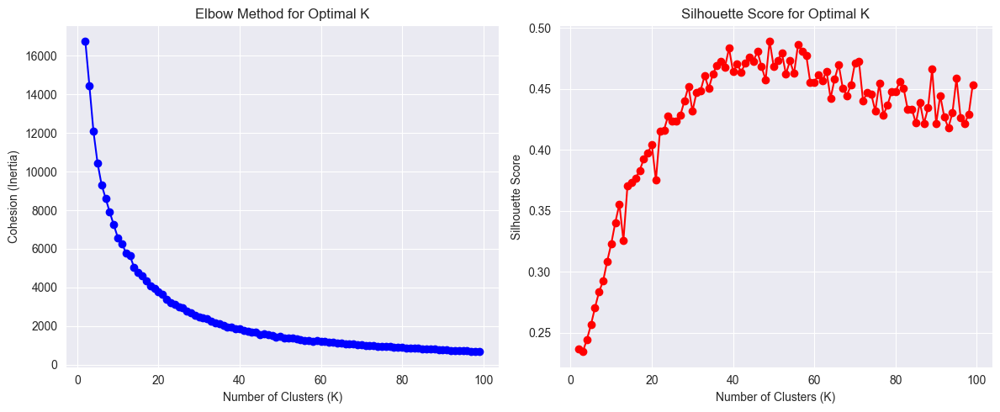

In [16]:
kmeans_list = clustering.plot_scores(real_stages_df)

Plots for optimal K

In [17]:
kmeans = kmeans_list[18]
centers = clustering.inverse_transform(kmeans.cluster_centers_, preprocessor_stages,
                                                      standardize_cols=stand_stage,
                                                      minmax_cols=minmax_stage,
                                                      categorical_cols=cat_stage)

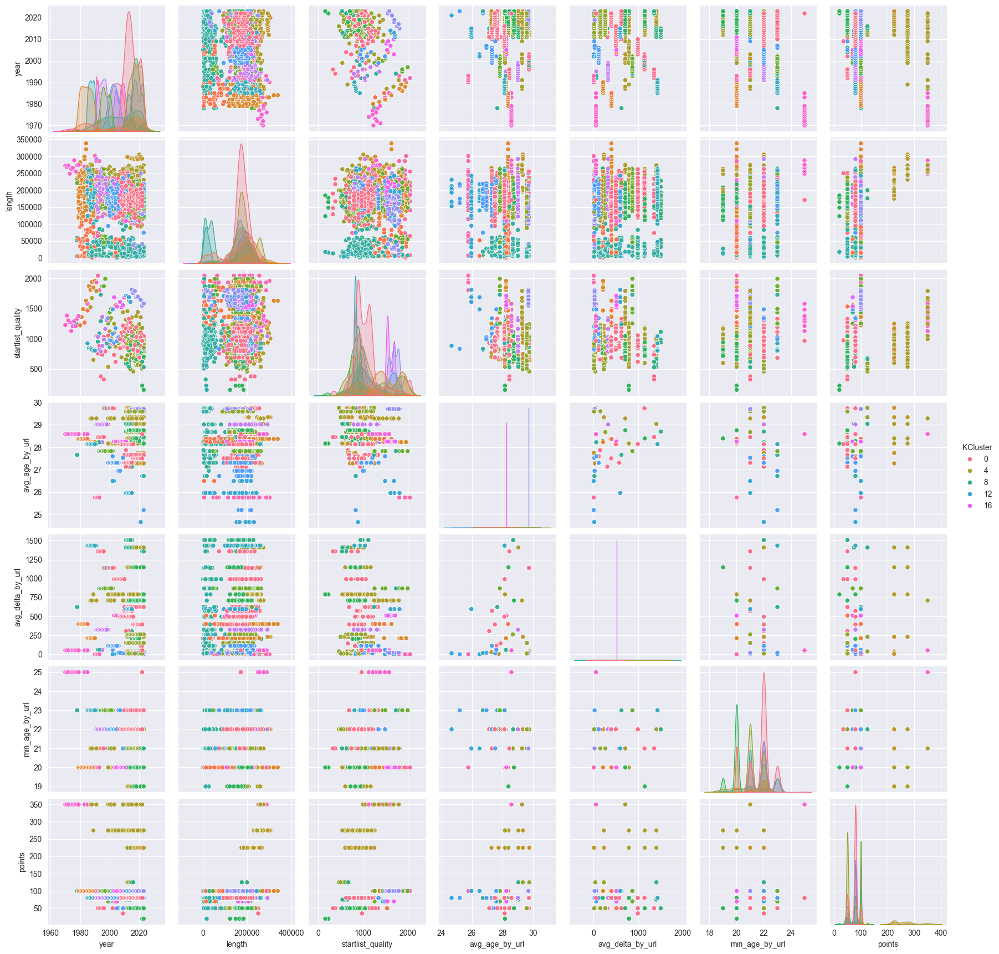

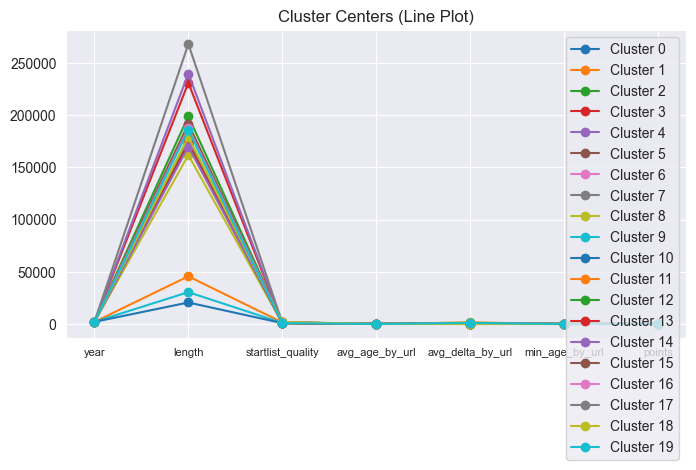

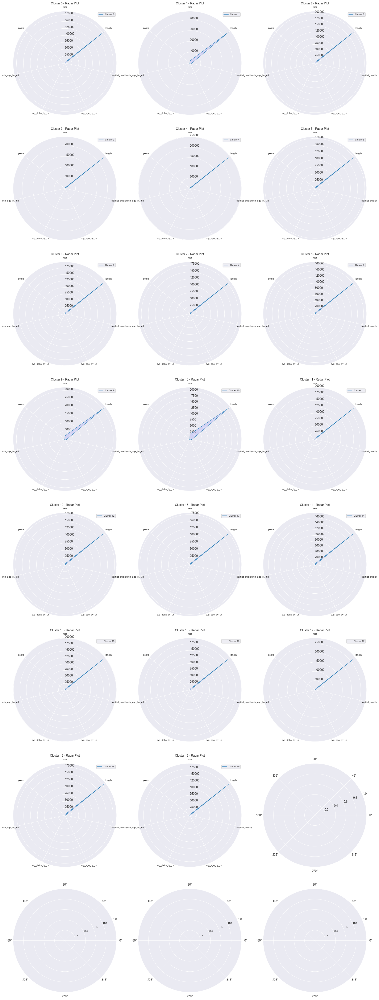

           year         length  startlist_quality  avg_age_by_url  \
0   2014.806911  178213.617886         990.520325       27.697748   
1   1990.508197   45668.032787        1551.147541       28.252018   
2   1984.201031  198939.175258        1585.097938       28.316826   
3   2018.125000  230945.833333         893.395833       28.825409   
4   2013.655914  239735.483871         990.591398       28.701034   
5   2017.558304  172820.848057         900.547703       29.338420   
6   1996.977612  188097.014925        1667.082090       27.827583   
7   2018.263682  177630.746269         826.273632       28.456623   
8   2014.895833  161729.166667         861.750000       28.694296   
9   2003.557576   30500.606061        1040.484848       28.037551   
10  2017.950000   20591.750000         840.525000       28.916739   
11  1987.596491  190817.543860         843.307018       28.140940   
12  2012.696629  173305.617978        1600.617978       25.893547   
13  2004.843575  172840.223464    

In [18]:
clustering.optimal_pair_plot(stages, 'KCluster', kmeans.labels_)
clustering.plot_centers(stages, centers, 8, 3)
print(centers)
print(centers.std().sort_values())

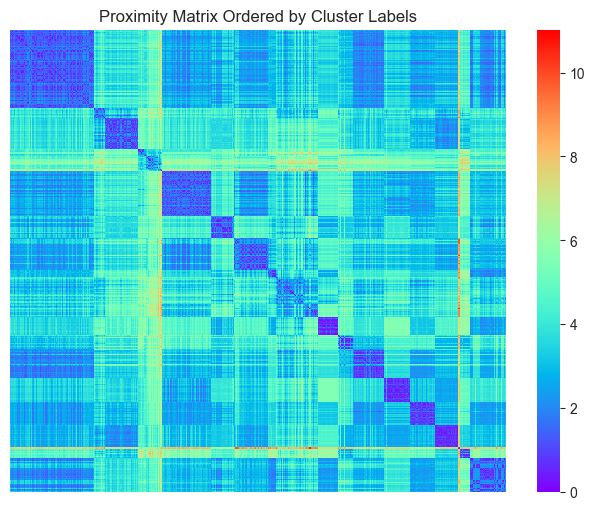

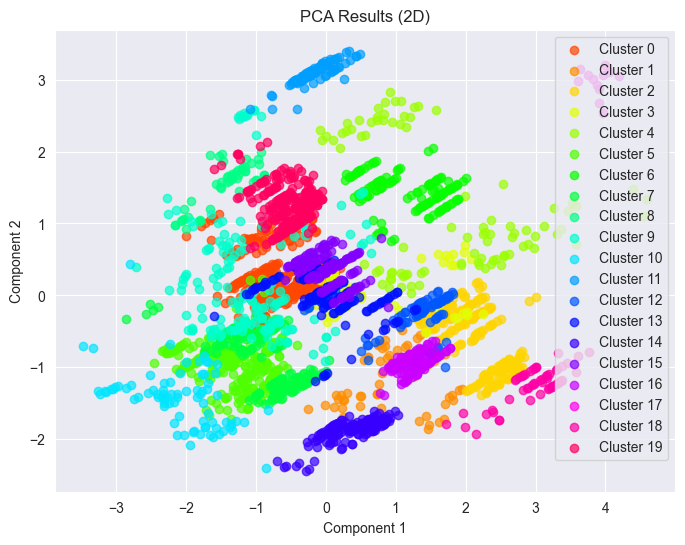

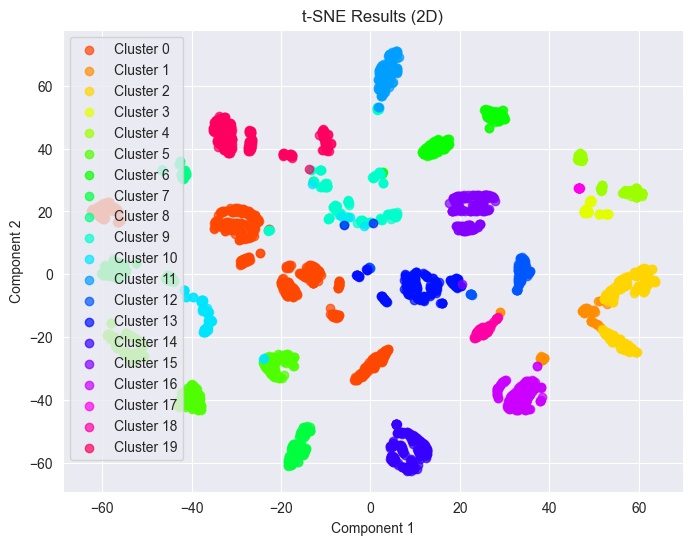

In [19]:
data_scaled = real_stages_df
labels = kmeans.labels_

clustering.similarity_matrix(real_stages_df, labels)

# 2D PCA
pca_2d = apply_pca(data_scaled, dimensions=2)
plot_results(pca_2d, labels, title="PCA Results (2D)", dimensions=2)

# 2D t-SNE
tsne_2d = apply_tsne(data_scaled, dimensions=2)
plot_results(tsne_2d, labels, title="t-SNE Results (2D)", dimensions=2)

### X-means cyclists

In [20]:
from sklearn.metrics import silhouette_score

labels, centroid = clustering.x_means(real_cyclists_df)

print(f"Silouette: {silhouette_score(real_cyclists_df, labels)}")

Done
Silouette: 0.20208037639205348


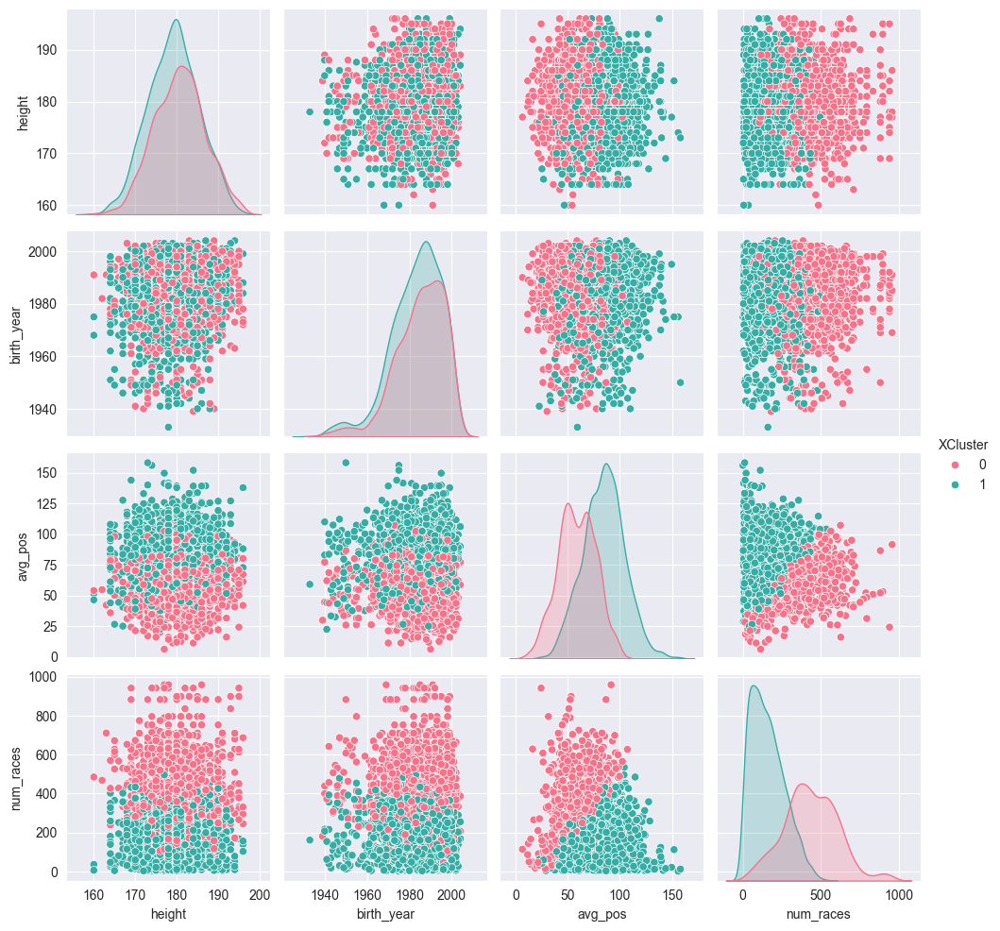

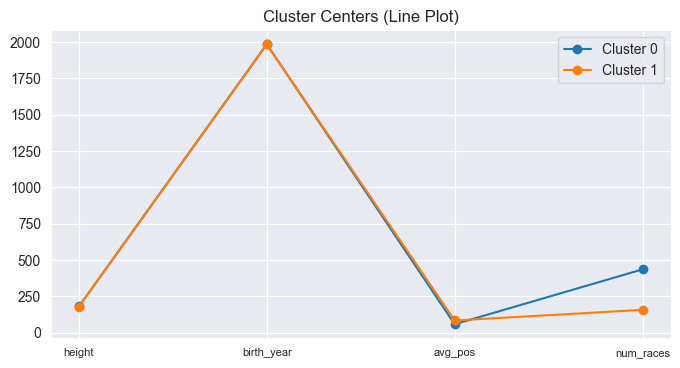

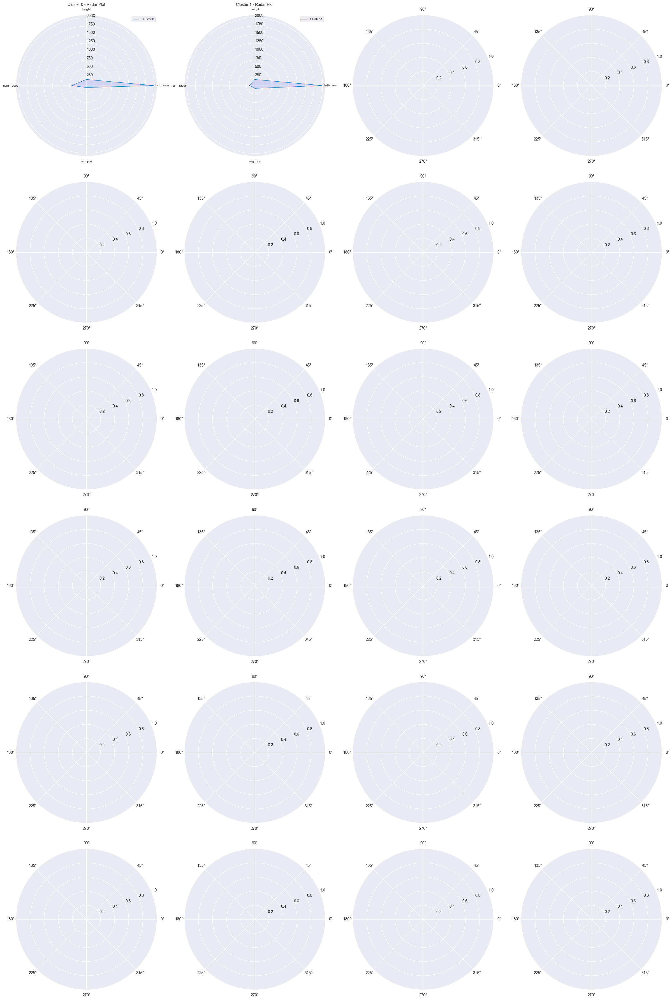

       height   birth_year    avg_pos   num_races
0  180.622956  1984.915979  58.596776  435.935484
1  179.224422  1983.127445  84.272956  157.601660
height          0.988913
birth_year      1.264684
avg_pos        18.155801
num_races     196.811734
dtype: float64


In [21]:
centers = clustering.inverse_transform(np.array(centroid), preprocessor_cyclists,
                                                      minmax_cols=minmax_cyclist,
                                                      standardize_cols=stand_cyclist,
                                                      categorical_cols=cat_cyclist)
clustering.optimal_pair_plot(cyclists, 'XCluster', labels)
clustering.plot_centers(cyclists, centers, 6, 4)
print(centers)
print(centers.std().sort_values())

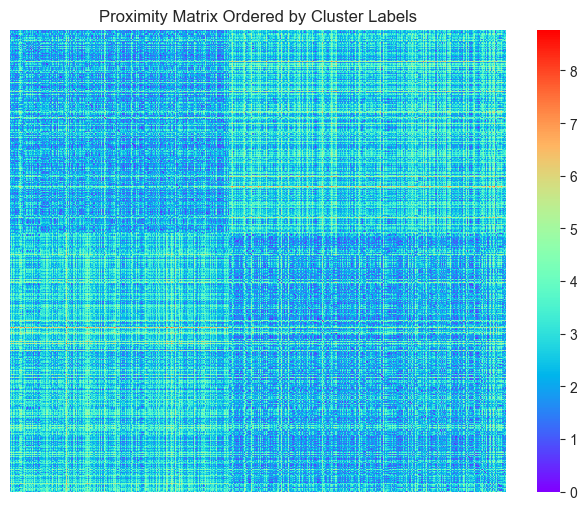

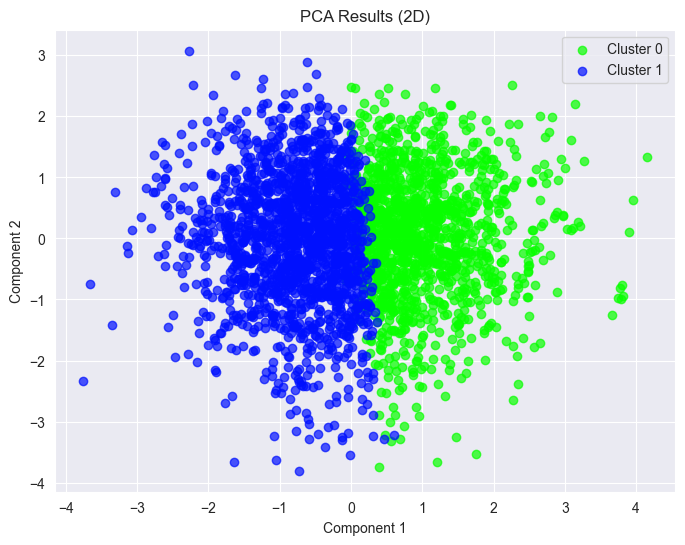

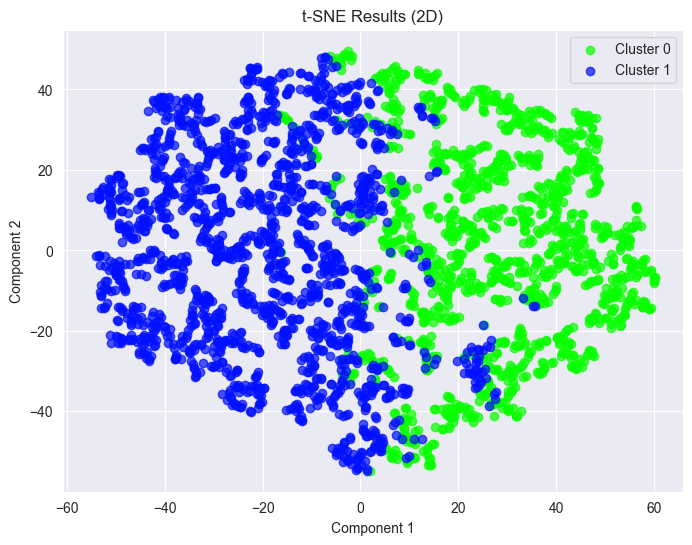

In [22]:
data_scaled = real_cyclists_df

clustering.similarity_matrix(real_cyclists_df, labels)
# 2D PCA
pca_2d = apply_pca(data_scaled, dimensions=2)
plot_results(pca_2d, labels, title="PCA Results (2D)", dimensions=2)

# 2D t-SNE
tsne_2d = apply_tsne(data_scaled, dimensions=2)
plot_results(tsne_2d, labels, title="t-SNE Results (2D)", dimensions=2)

### X-means stages

In [23]:
labels, centroid = clustering.x_means(real_stages_df)

print(f"Silouette: {silhouette_score(real_stages_df, labels)}")

Done
Silouette: 0.3858522171277414


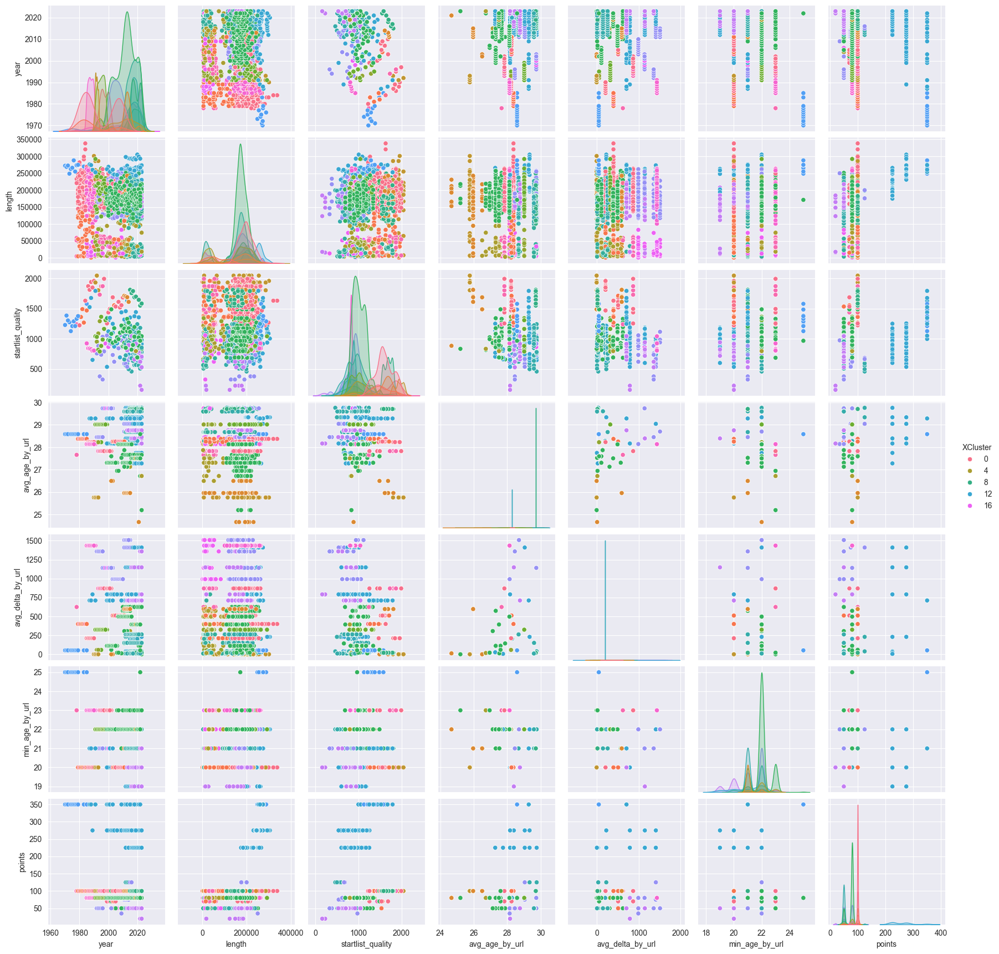

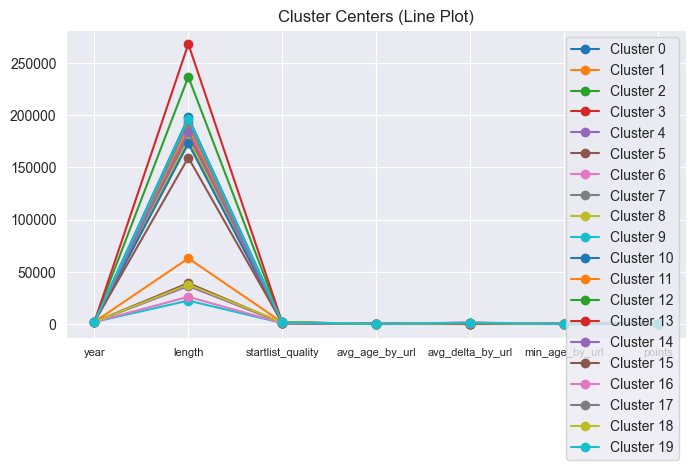

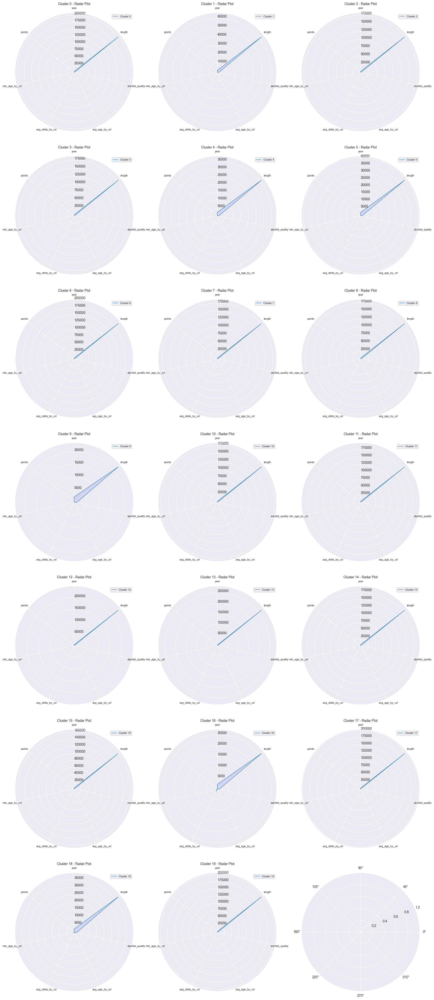

           year         length  startlist_quality  avg_age_by_url  \
0   1994.031847  197803.821656        1597.506369       28.289432   
1   1989.093333   62900.666667        1535.840000       28.318008   
2   2012.696629  173305.617978        1600.617978       25.893547   
3   1991.750000  179153.571429        1939.250000       25.761905   
4   2011.459770   36337.356322        1031.735632       27.512809   
5   1994.321429   39203.571429        1025.107143       28.876441   
6   1994.760274  191600.684932        1014.732877       29.012231   
7   2012.108434  177649.397590        1009.698795       27.564098   
8   2019.048611  176776.388889        1685.791667       29.708571   
9   2018.025974   22403.246753         936.558442       29.117421   
10  2017.563830  173150.709220         899.879433       29.334216   
11  2017.838384  187454.545455         862.666667       28.283186   
12  2015.177305  236743.262411         957.503546       28.743374   
13  1976.083333  268117.500000    

In [24]:
centers = clustering.inverse_transform(np.array(centroid), preprocessor_stages,
                                                      standardize_cols=stand_stage,
                                                      minmax_cols=minmax_stage,
                                                      categorical_cols=cat_stage)
clustering.optimal_pair_plot(stages, 'XCluster', labels)
clustering.plot_centers(stages, centers, 7, 3)
print(centers)
print(centers.std().sort_values())

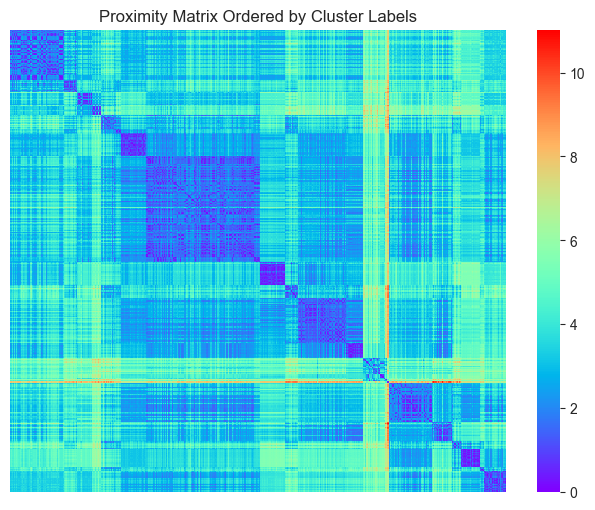

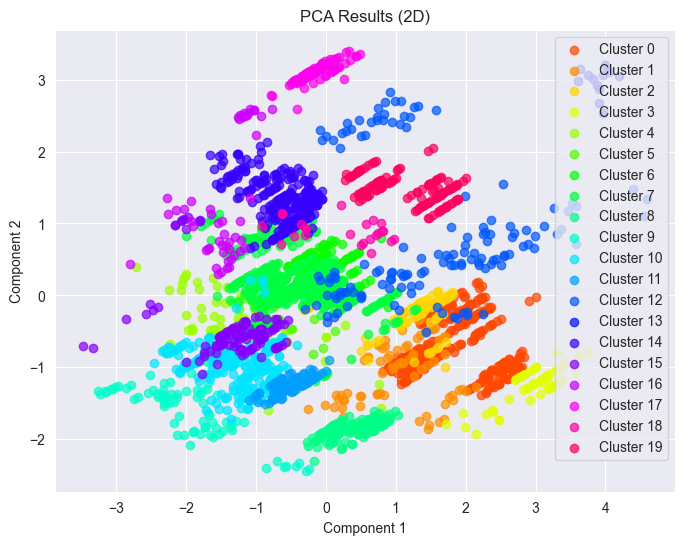

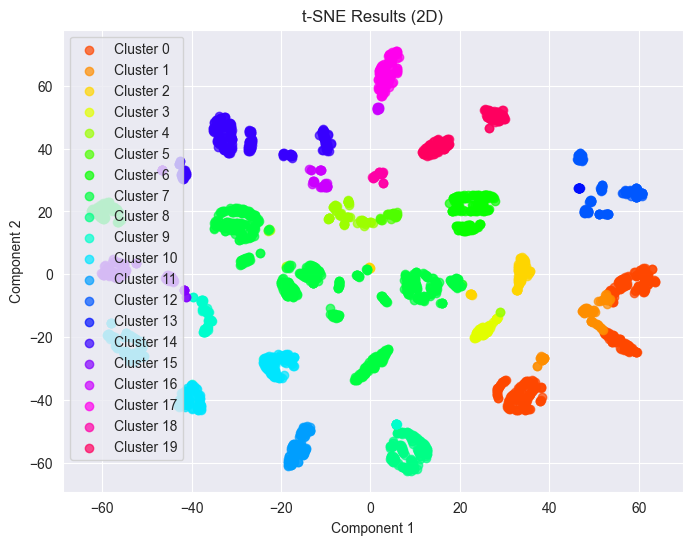

In [25]:
data_scaled = real_stages_df

clustering.similarity_matrix(real_stages_df, labels)
# 2D PCA
pca_2d = apply_pca(data_scaled, dimensions=2)
plot_results(pca_2d, labels, title="PCA Results (2D)", dimensions=2)

# 2D t-SNE
tsne_2d = apply_tsne(data_scaled, dimensions=2)
plot_results(tsne_2d, labels, title="t-SNE Results (2D)", dimensions=2)

## Hierarchical 

Define linkage methods to try

In [26]:
# Let's use methods less susceptible to outliers and noise
# linkage_methods = ["single", "complete", "average", "ward", "centroid", "median"]
linkage_methods = ["average", "ward", "centroid"]

### Cyclists link

Compute distance matrices for cyclists

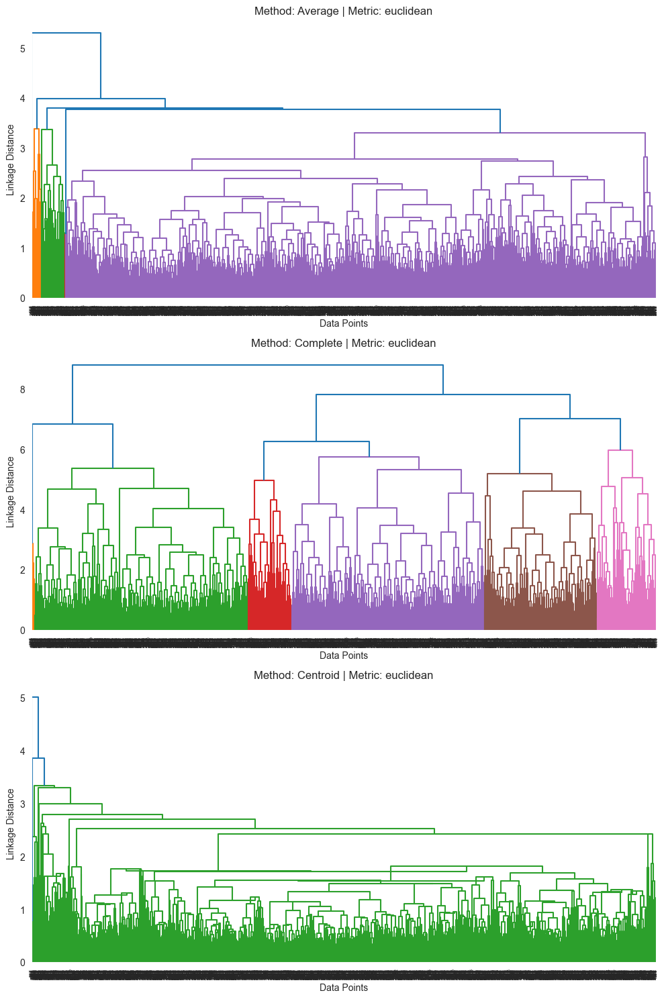

In [27]:
dst_matrix_euclid_cyclists = clustering.compute_distance_matrix(real_cyclists_df,"euclidean")
euclid_link = clustering.compute_hc(dst_matrix_euclid_cyclists, methods=['average', 'complete', 'centroid'])
clustering.plot_all_hc(euclid_link, "euclidean")

Here the number of clusters is not perfectly clear, but the maximum distance is enough clear and we can see that the number of clusters is between 2 3 or 4

### Stages links

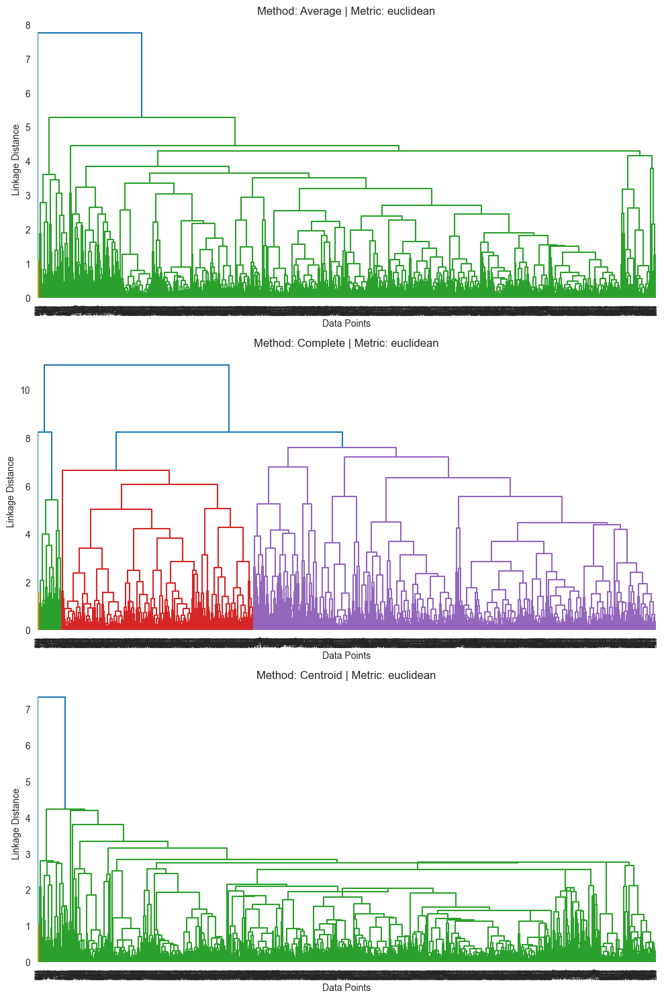

In [28]:
dst_matrix_euclid_stages = clustering.compute_distance_matrix(real_stages_df, "euclidean")
euclid_link = clustering.compute_hc(dst_matrix_euclid_stages, methods=['average', 'complete', 'centroid'])
clustering.plot_all_hc(euclid_link, "euclidean")

2 is where there is the maximum distance. so clusters are 2

### Spectral method

According to spectral method. No clusters are found

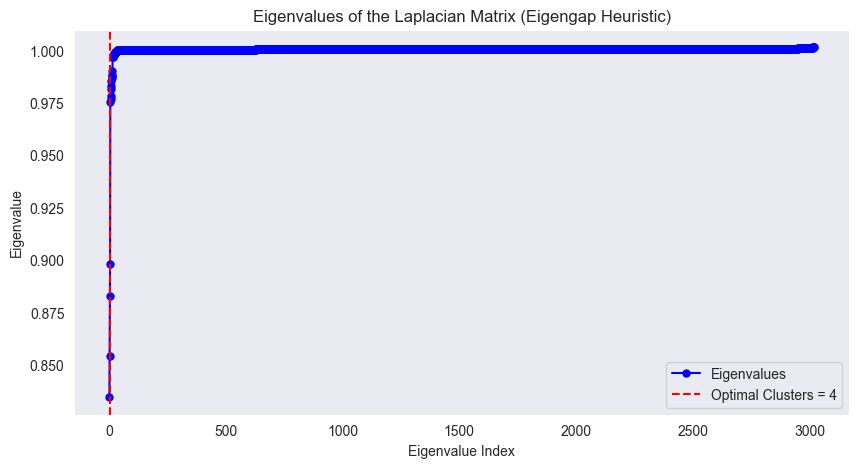

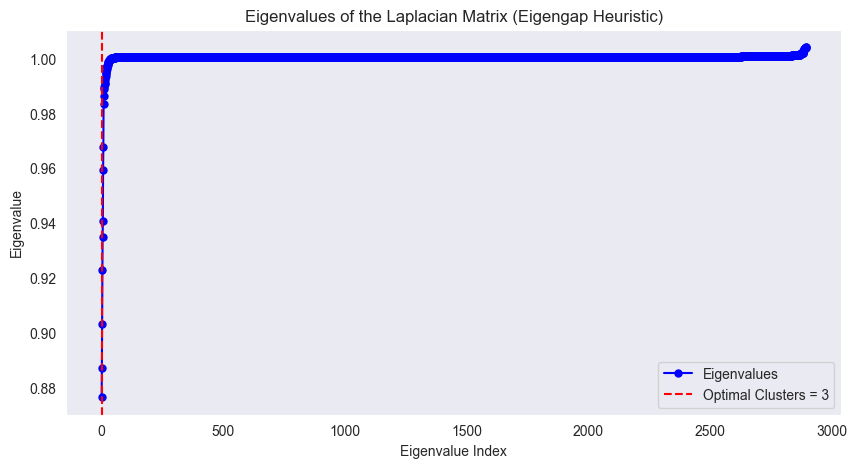

In [29]:
import libraries.clustering as clustering
clustering.spectral_eigen_gap(real_cyclists_df.values)
clustering.spectral_eigen_gap(real_stages_df.values)

### Cyclists agglomerative

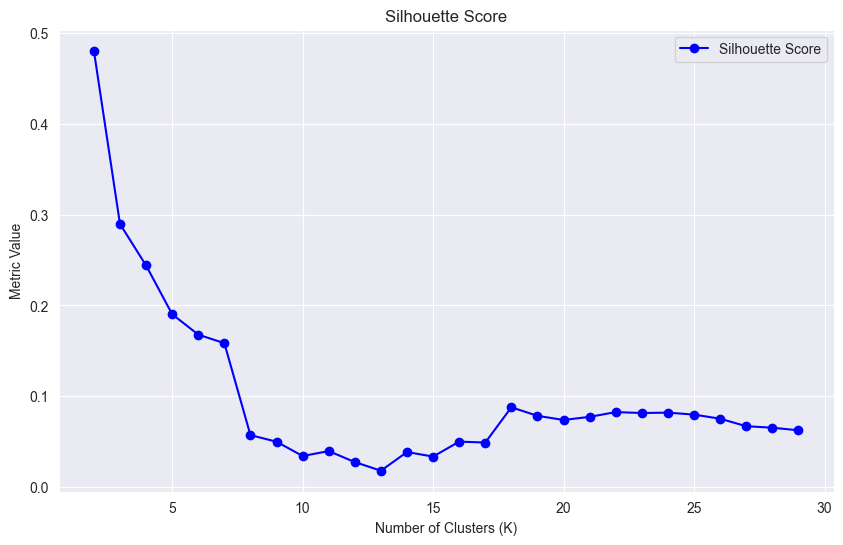

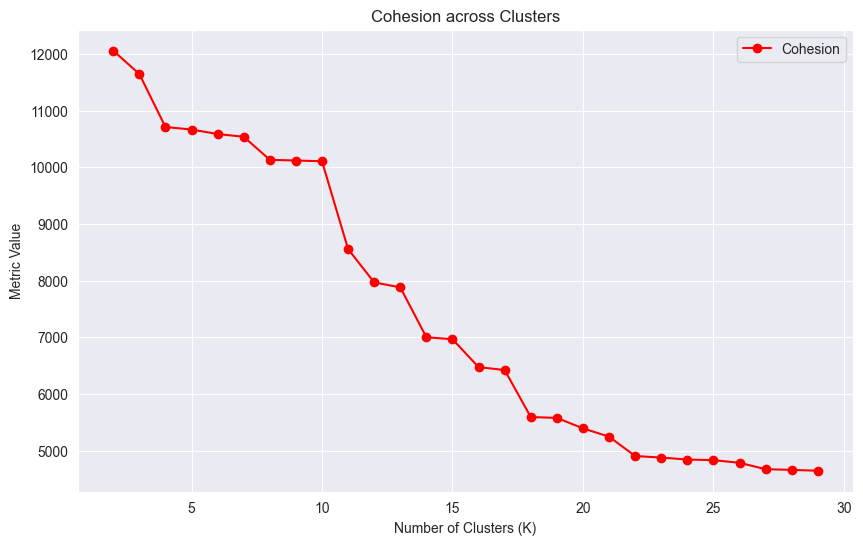

In [30]:
from sklearn.cluster import AgglomerativeClustering

agglr_labels_cyclists = []
for num_clusters in range(2, 30):
    agg_clustering = AgglomerativeClustering(n_clusters=num_clusters, linkage='average')
    agglr_labels_cyclists.append(agg_clustering.fit_predict(real_cyclists_df))

sil1,coh1 = sil_vs_coh(real_cyclists_df, agglr_labels_cyclists, list(range(2,30)))

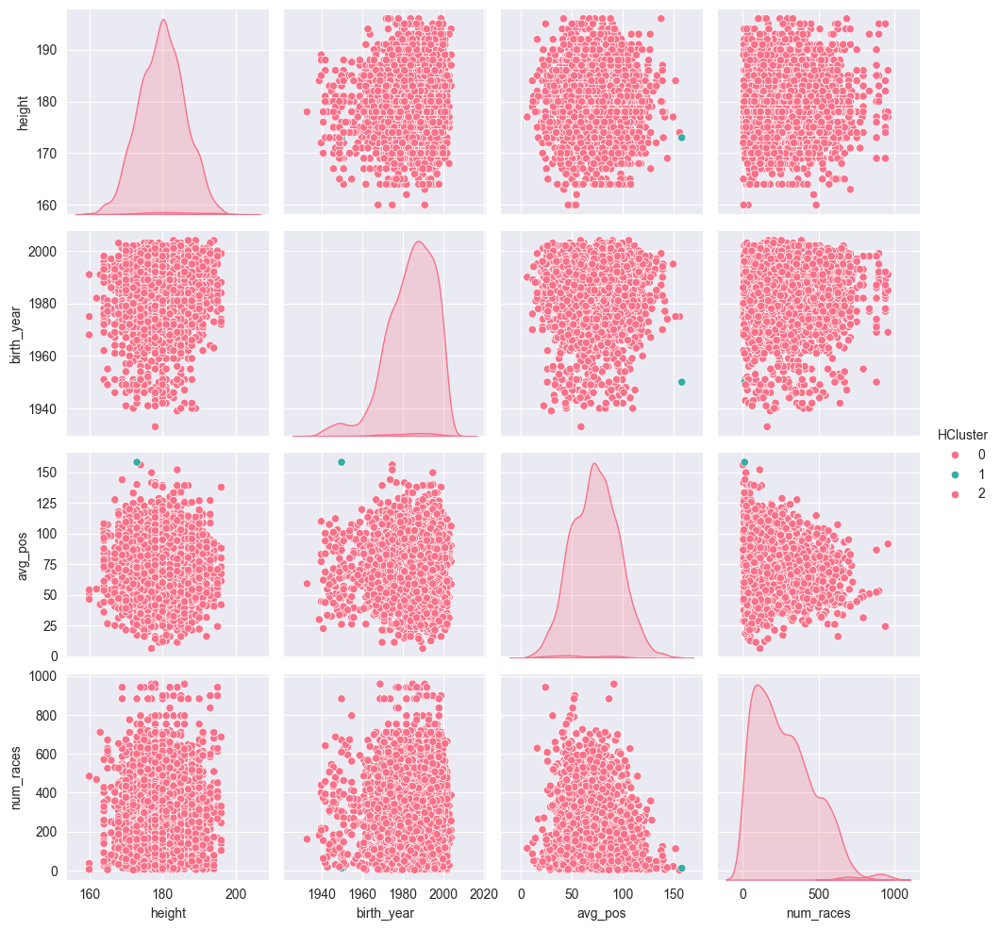

In [31]:
agg_clustering = AgglomerativeClustering(n_clusters=3, linkage='average')
labels = agg_clustering.fit_predict(real_cyclists_df)
clustering.optimal_pair_plot(cyclists, 'HCluster', labels)

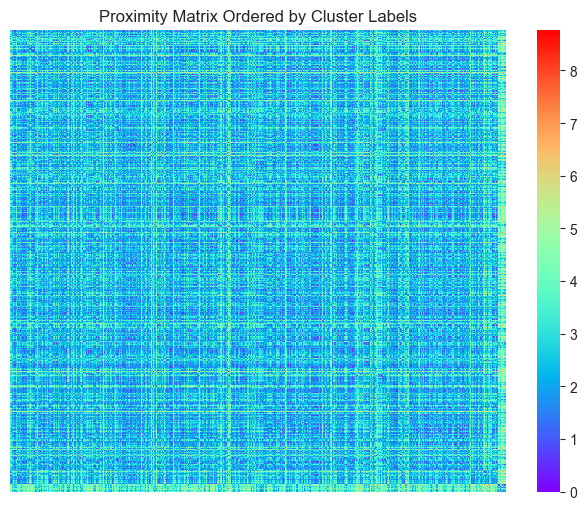

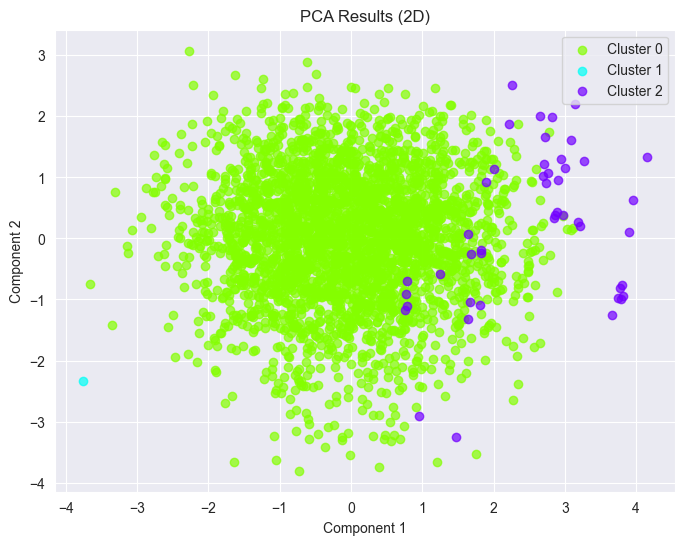

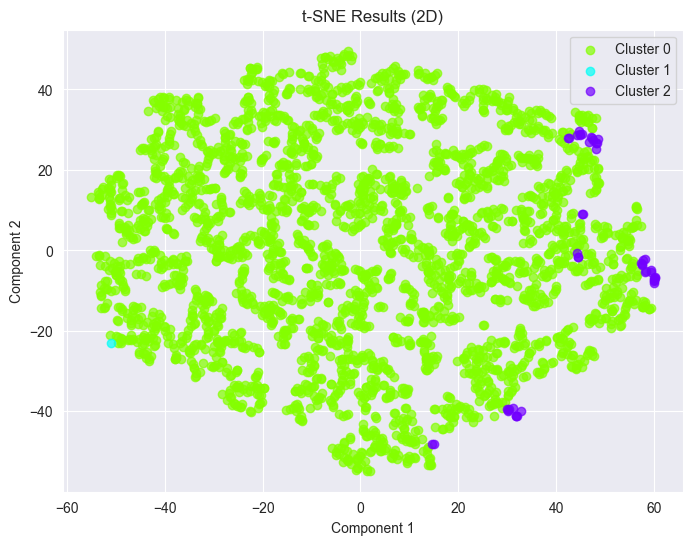

In [32]:
data_scaled = real_cyclists_df

clustering.similarity_matrix(real_cyclists_df, labels)
# 2D PCA
pca_2d = apply_pca(data_scaled, dimensions=2)
plot_results(pca_2d, labels, title="PCA Results (2D)", dimensions=2)

# 2D t-SNE
tsne_2d = apply_tsne(data_scaled, dimensions=2)
plot_results(tsne_2d, labels, title="t-SNE Results (2D)", dimensions=2)

### Stages agglomerative

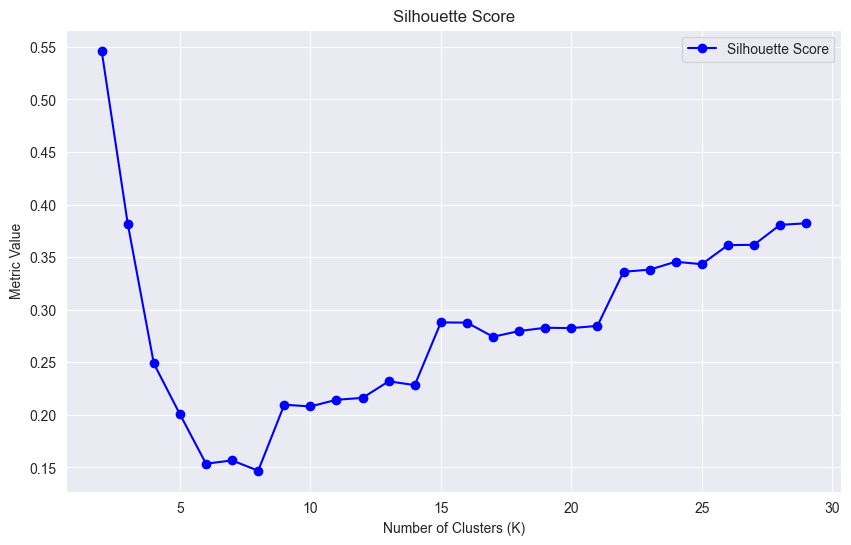

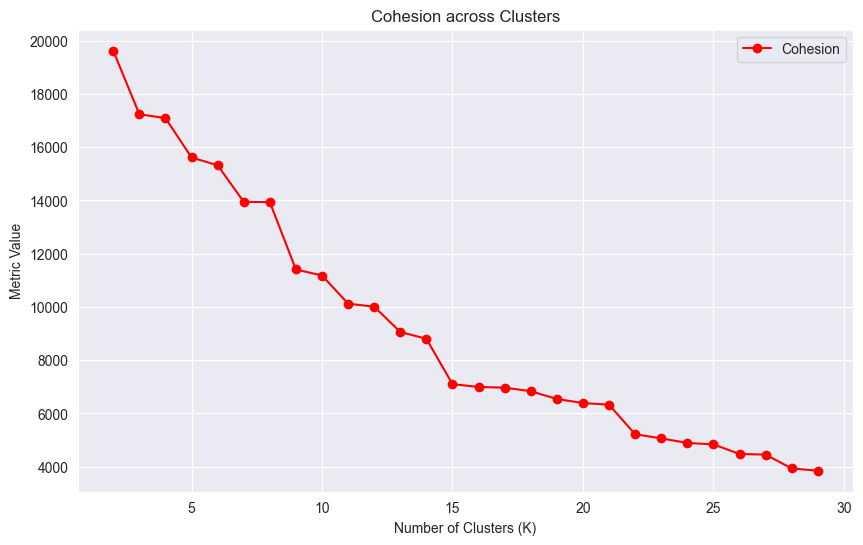

In [33]:
from sklearn.cluster import AgglomerativeClustering

agglr_labels_stages = []
for num_clusters in range(2, 30):
    agg_clustering = AgglomerativeClustering(n_clusters=num_clusters, linkage='average')
    agglr_labels_stages.append(agg_clustering.fit_predict(real_stages_df))

sil1,coh1 = sil_vs_coh(real_stages_df, agglr_labels_stages, list(range(2,30)))

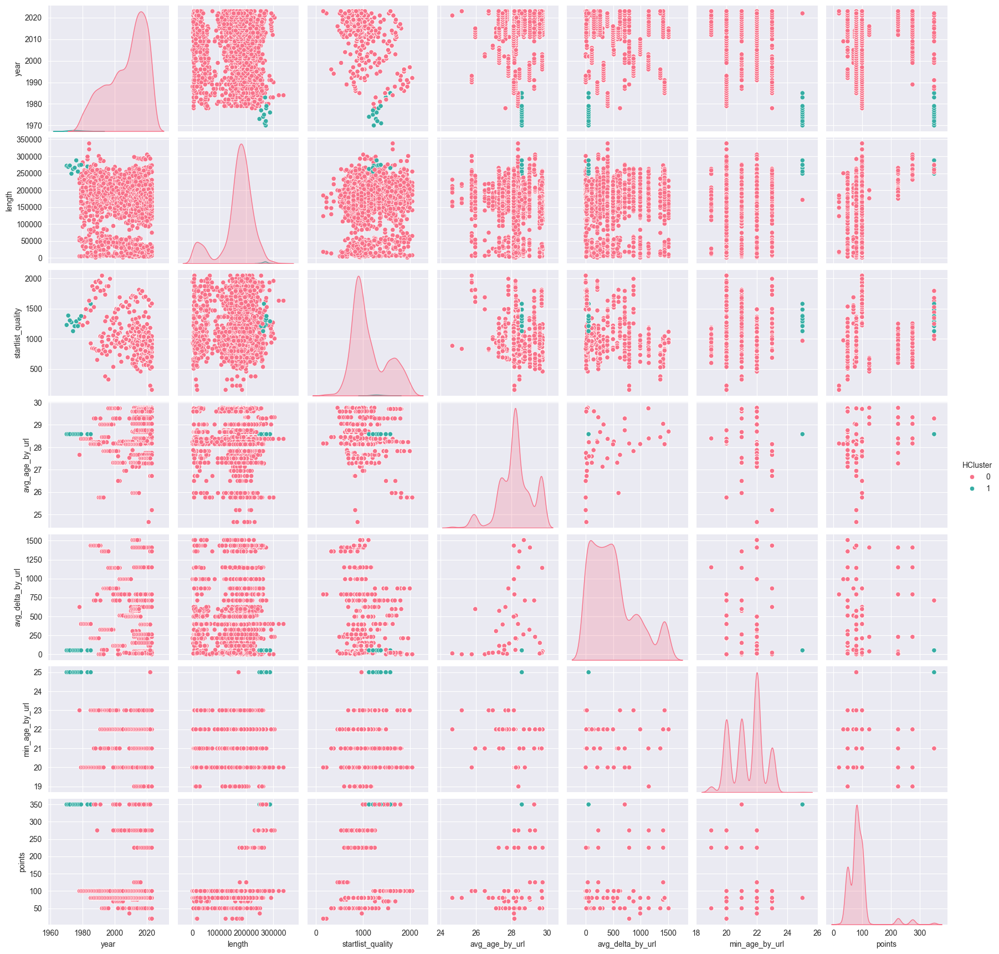

In [34]:
agg_clustering = AgglomerativeClustering(n_clusters=2, linkage='average')
labels = agg_clustering.fit_predict(real_stages_df)
clustering.optimal_pair_plot(stages, 'HCluster', labels)

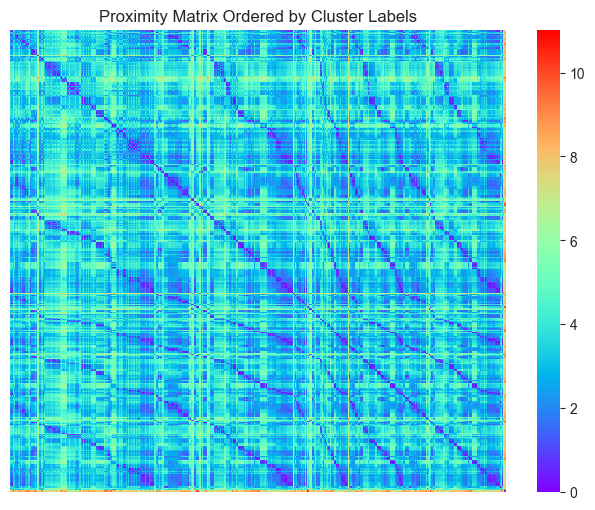

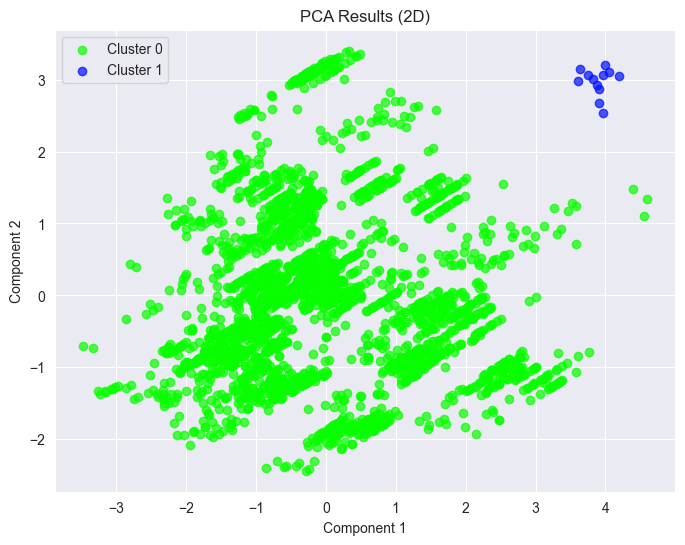

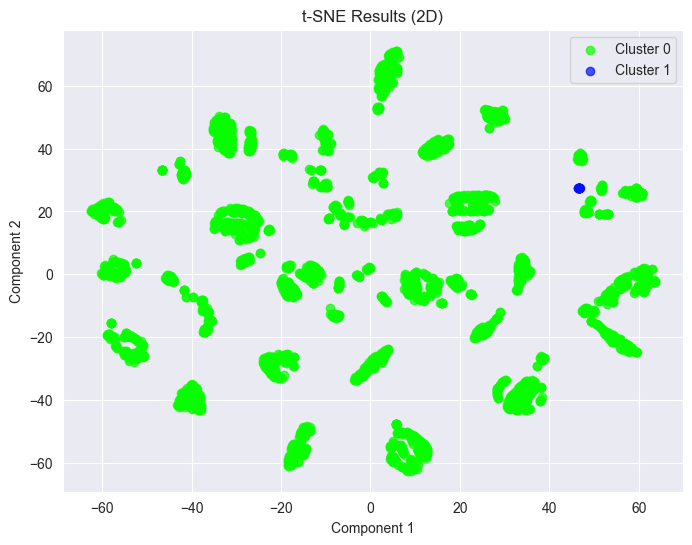

In [35]:
data_scaled = real_stages_df

clustering.similarity_matrix(real_stages_df, labels)
# 2D PCA
pca_2d = apply_pca(data_scaled, dimensions=2)
plot_results(pca_2d, labels, title="PCA Results (2D)", dimensions=2)

# 2D t-SNE
tsne_2d = apply_tsne(data_scaled, dimensions=2)
plot_results(tsne_2d, labels, title="t-SNE Results (2D)", dimensions=2)

### Cyclists spectral

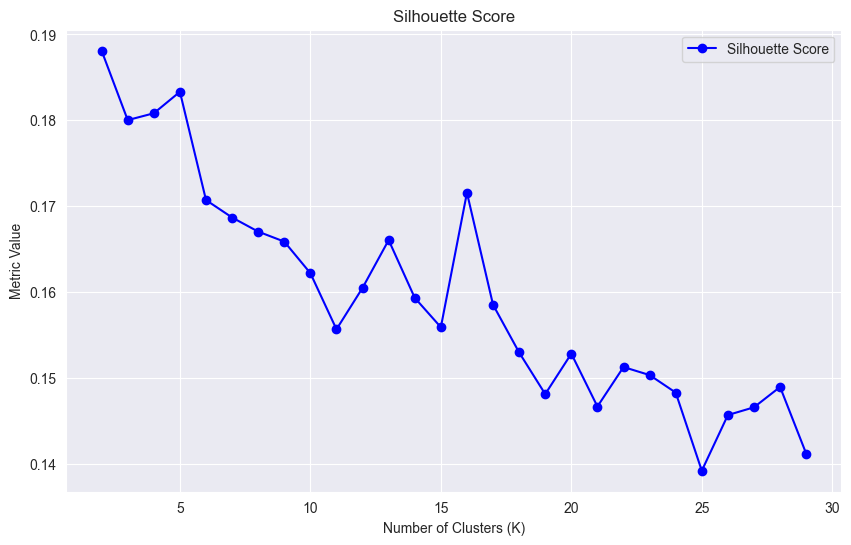

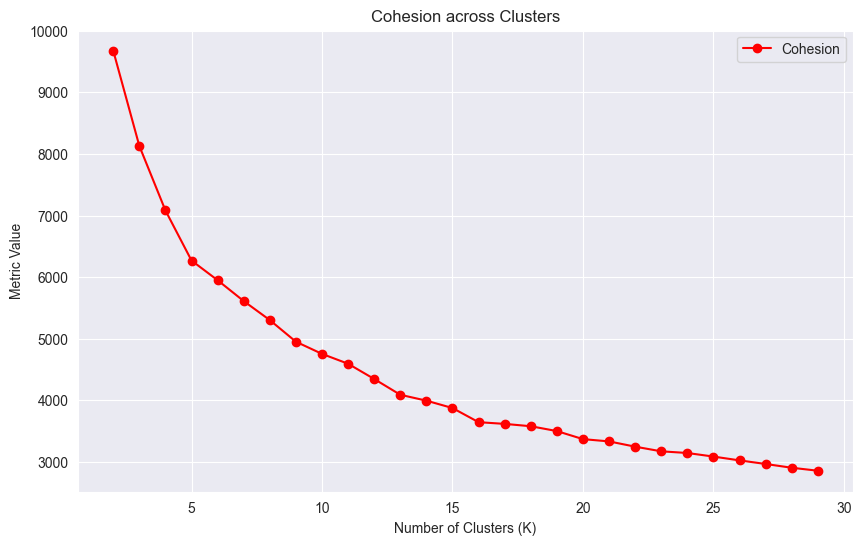

In [36]:
spect_labels_cyclists = []
for n_clusters in range(2, 30):
    spectral = SpectralClustering(n_clusters=n_clusters, affinity='nearest_neighbors', random_state=1804)
    spect_labels_cyclists.append(spectral.fit_predict(real_cyclists_df))

sil3,coh3 = sil_vs_coh(real_cyclists_df, spect_labels_cyclists, list(range(2,30)))

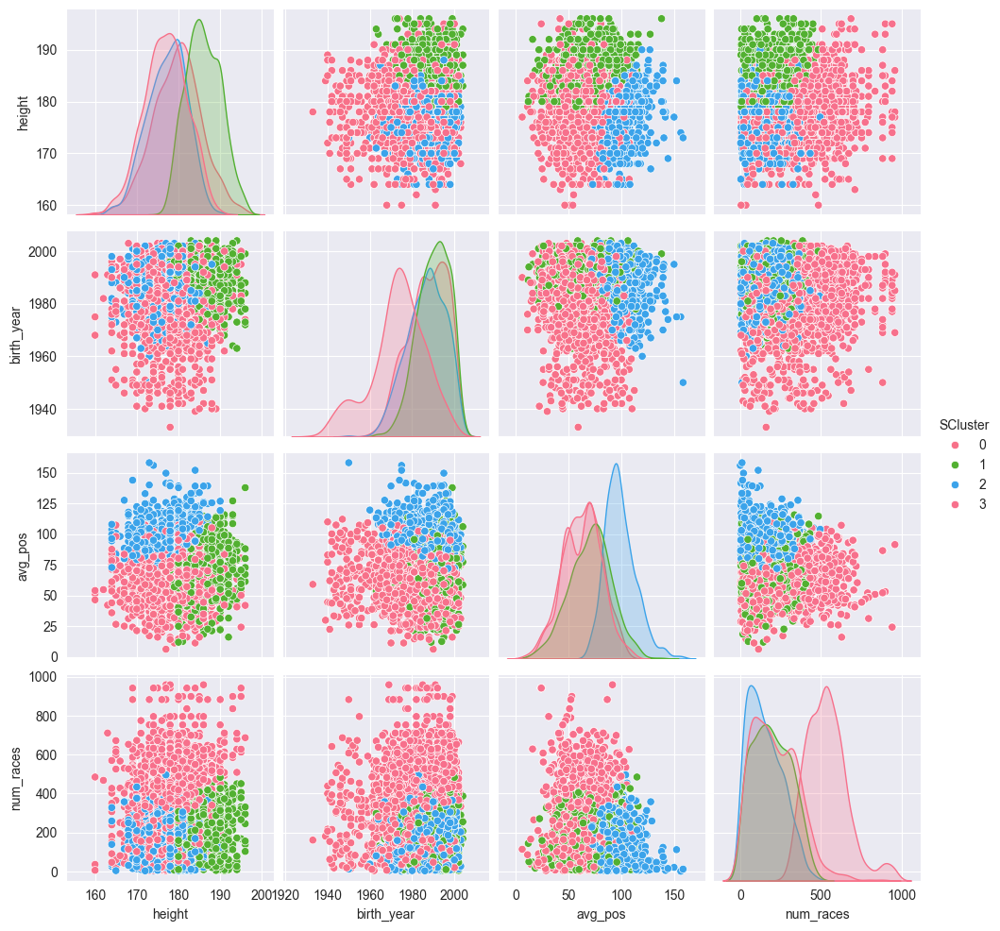

In [37]:
spect_clustering = SpectralClustering(n_clusters=4, affinity='nearest_neighbors', random_state=1804)
labels = spect_clustering.fit_predict(real_cyclists_df)
clustering.optimal_pair_plot(cyclists, 'SCluster', labels)

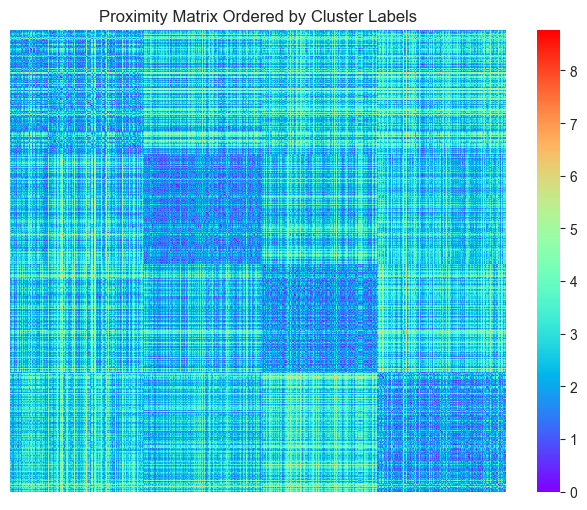

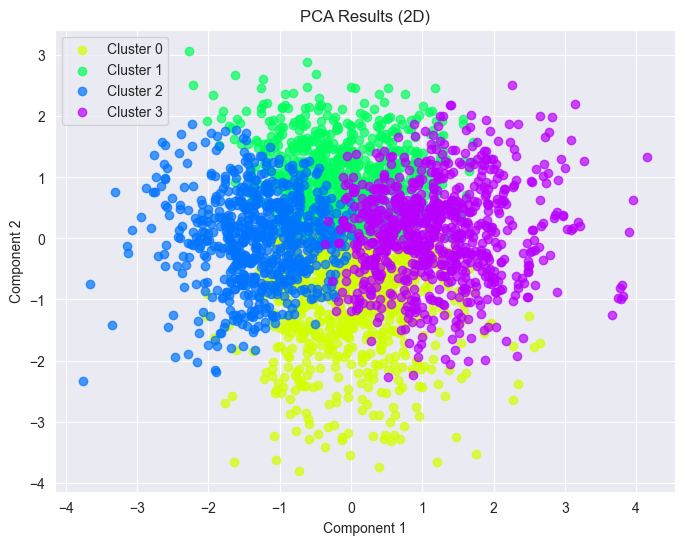

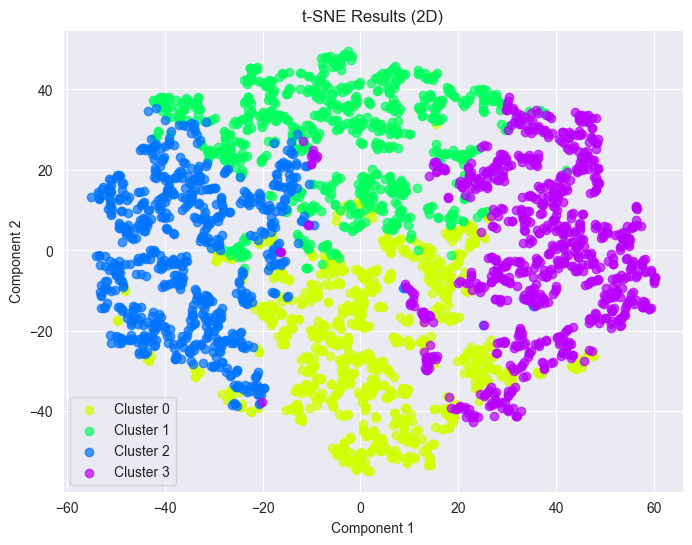

In [38]:
data_scaled = real_cyclists_df

clustering.similarity_matrix(real_cyclists_df, labels)
# 2D PCA
pca_2d = apply_pca(data_scaled, dimensions=2)
plot_results(pca_2d, labels, title="PCA Results (2D)", dimensions=2)

# 2D t-SNE
tsne_2d = apply_tsne(data_scaled, dimensions=2)
plot_results(tsne_2d, labels, title="t-SNE Results (2D)", dimensions=2)

### Stages spectral

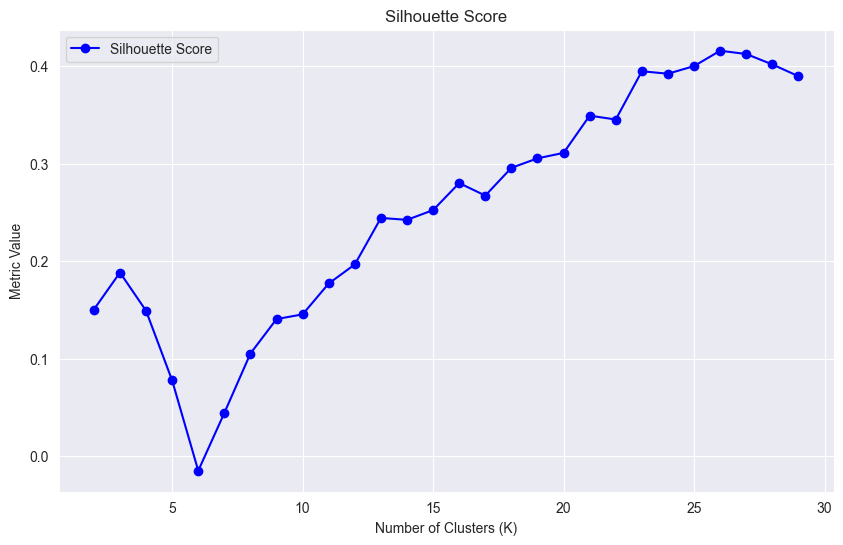

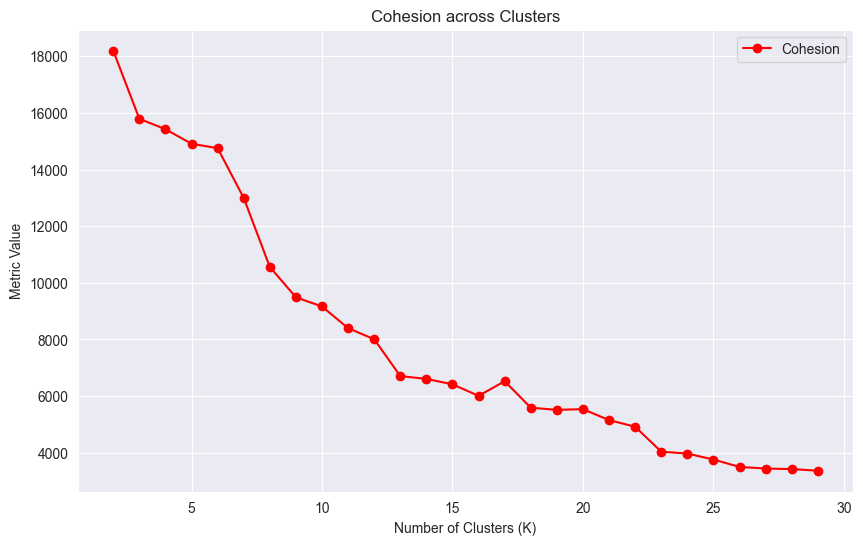

In [39]:
from sklearn.cluster import SpectralClustering

spect_labels_stages = []
for n_clusters in range(2, 30):
    spectral = SpectralClustering(n_clusters=n_clusters, affinity='nearest_neighbors', n_neighbors=50, random_state=1804)
    spect_labels_stages.append(spectral.fit_predict(real_stages_df))

sil4,coh4 = sil_vs_coh(real_stages_df, spect_labels_stages, list(range(2,30)))

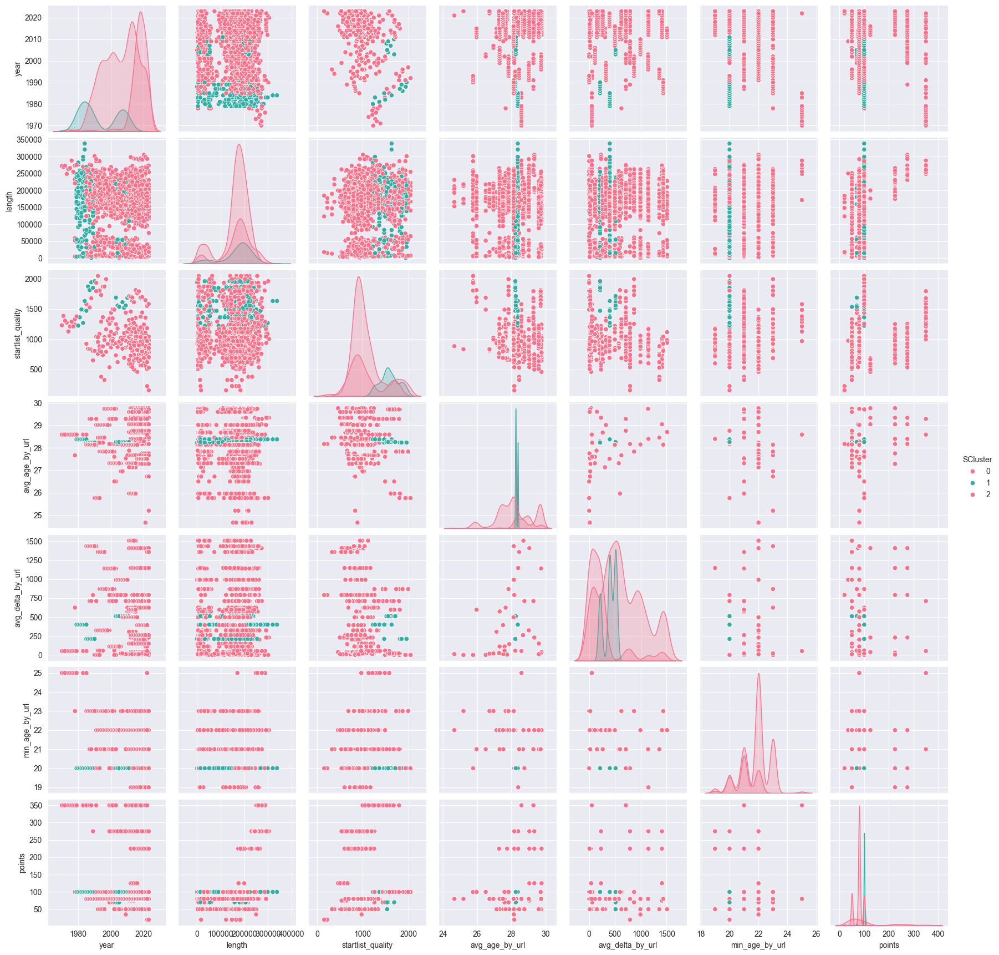

In [40]:
spect_clustering = SpectralClustering(n_clusters=3, affinity='nearest_neighbors', n_neighbors=50, random_state=1804)
labels = spect_clustering.fit_predict(real_stages_df)
clustering.optimal_pair_plot(stages, 'SCluster', labels)

Note: Spectral clustering detects isolated points for stages with KNN

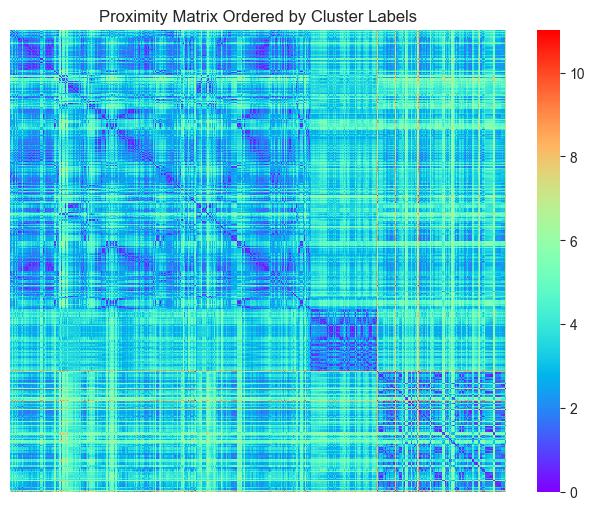

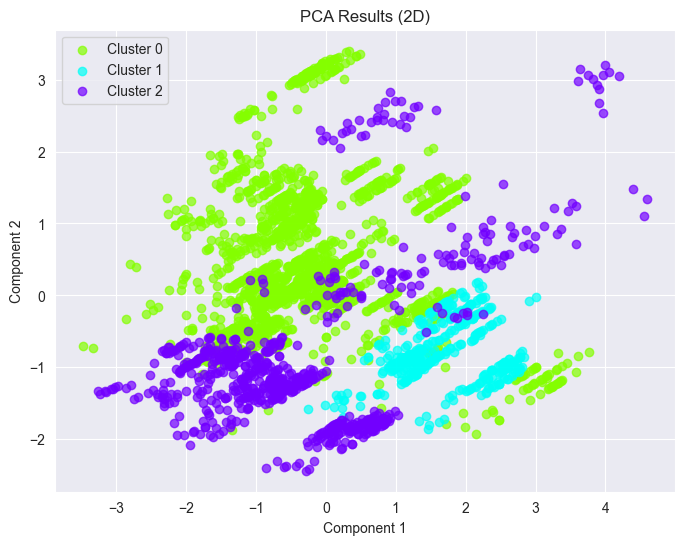

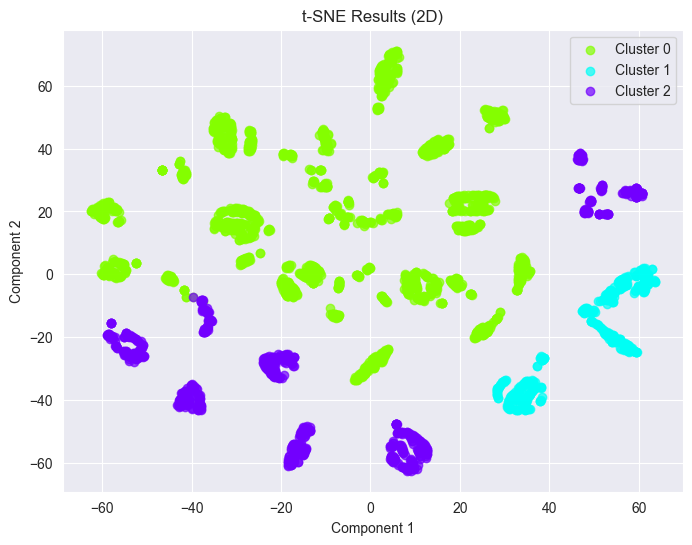

In [41]:
data_scaled = real_stages_df

clustering.similarity_matrix(real_stages_df, labels)
# 2D PCA
pca_2d = apply_pca(data_scaled, dimensions=2)
plot_results(pca_2d, labels, title="PCA Results (2D)", dimensions=2)

# 2D t-SNE
tsne_2d = apply_tsne(data_scaled, dimensions=2)
plot_results(tsne_2d, labels, title="t-SNE Results (2D)", dimensions=2)

## DBscan

### Cyclists

In [60]:
dst_matrix_euclid_cyclists = clustering.compute_distance_matrix(real_cyclists_df,"euclidean")
dst_matrix_euclid_cyclists = squareform(dst_matrix_euclid_cyclists)
ks = [real_cyclists_df.shape[1] * 2]

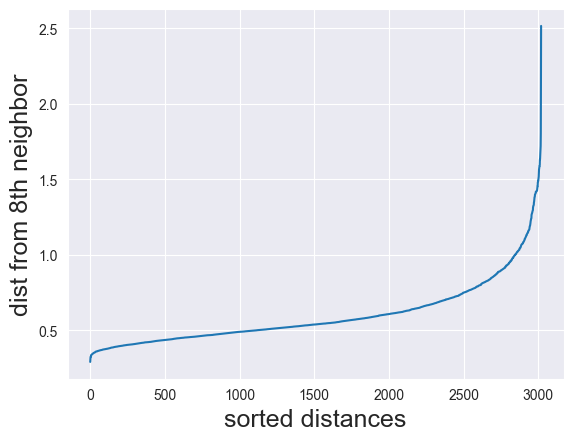

In [61]:
for dist, k in zip([dst_matrix_euclid_cyclists], ks):
    kth_distances = list()
    for d in dist:
        index_kth_distance = np.argsort(d)[k]
        kth_distances.append(d[index_kth_distance])

    plt.plot(range(0, len(kth_distances)), sorted(kth_distances))
    plt.ylabel("dist from %sth neighbor" % k, fontsize=18)
    plt.xlabel("sorted distances", fontsize=18)
    plt.show()

     eps  Clusters   Noise
0   0.50       4.0  2065.0
1   0.51       4.0  1935.0
2   0.52       2.0  1789.0
3   0.53       3.0  1686.0
4   0.54       3.0  1607.0
5   0.55       3.0  1489.0
6   0.56       1.0  1374.0
7   0.57       1.0  1276.0
8   0.58       1.0  1212.0
9   0.59       2.0  1101.0
10  0.60       2.0  1027.0
11  0.61       2.0   935.0
12  0.62       2.0   871.0
13  0.63       2.0   791.0
14  0.64       2.0   721.0
15  0.65       2.0   689.0
16  0.66       2.0   647.0
17  0.67       1.0   585.0
18  0.68       1.0   535.0
19  0.69       1.0   504.0
20  0.70       1.0   474.0
21  0.71       1.0   448.0
22  0.72       1.0   419.0
23  0.73       1.0   395.0
24  0.74       1.0   373.0
25  0.75       1.0   356.0
26  0.76       1.0   332.0
27  0.77       1.0   315.0
28  0.78       1.0   301.0
29  0.79       1.0   285.0
30  0.80       1.0   267.0
31  0.81       1.0   248.0
32  0.82       1.0   235.0
33  0.83       1.0   225.0
34  0.84       1.0   217.0
35  0.85       1.0   206.0
3

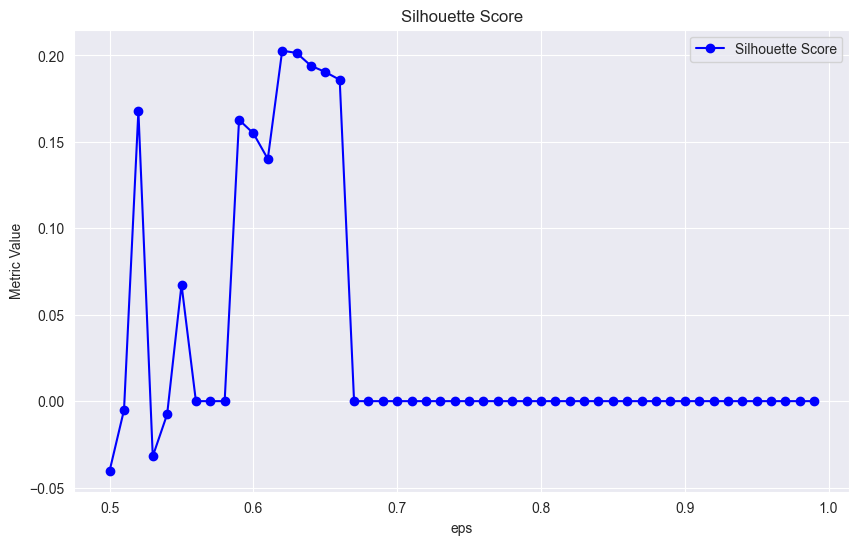

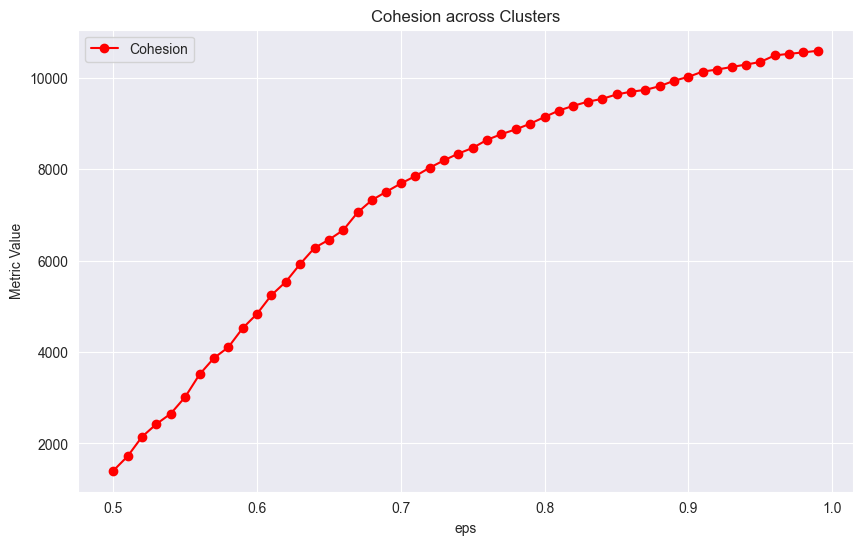

In [62]:
clustering.dbscan_tune(real_cyclists_df, dst_matrix_euclid_cyclists, np.arange(0.5, 1.0, 0.01))

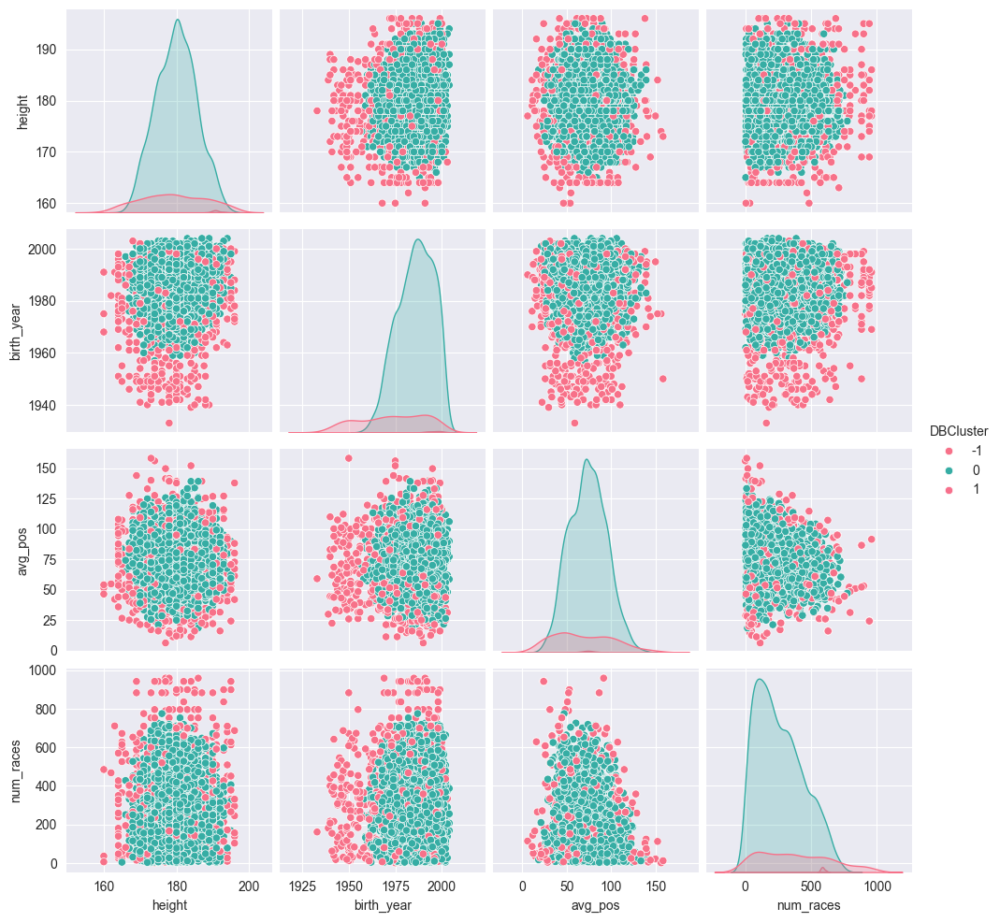

In [63]:
dbscan = DBSCAN(eps=0.62, min_samples=2*real_cyclists_df.shape[1], metric="precomputed", n_jobs=-1)
dbscan.fit_predict(dst_matrix_euclid_cyclists)
labels = dbscan.labels_

clustering.optimal_pair_plot(cyclists, 'DBCluster', labels)

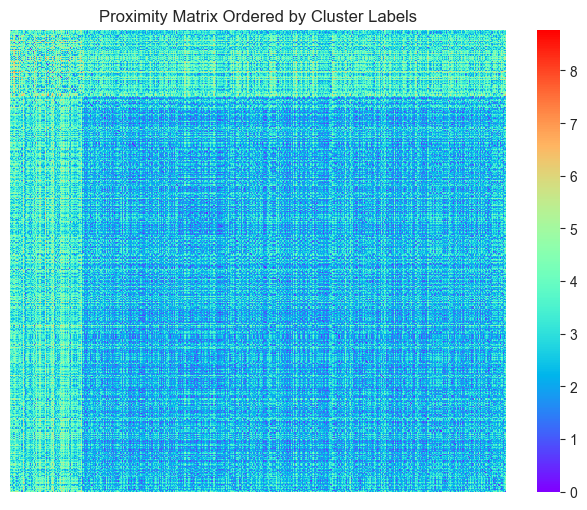

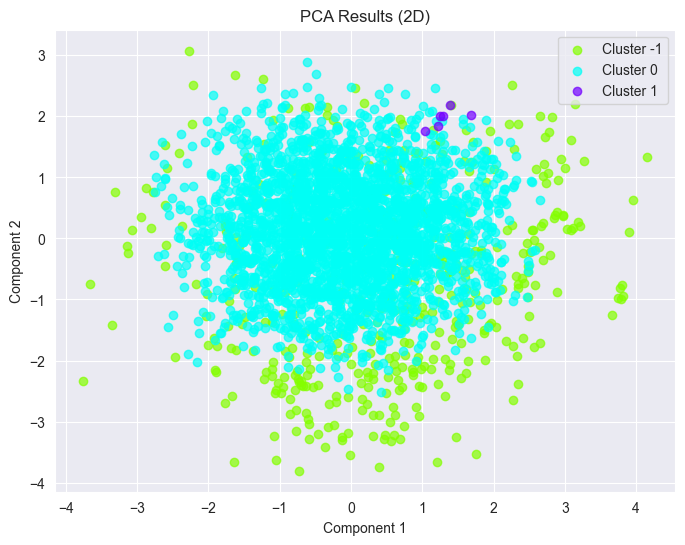

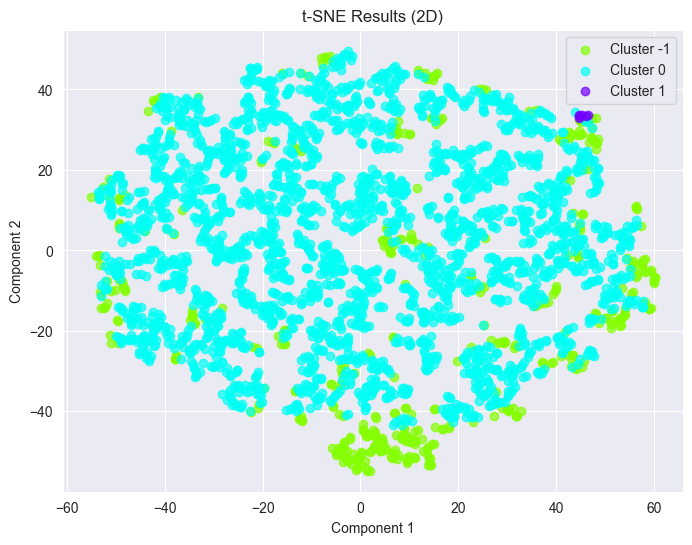

In [64]:
data_scaled = real_cyclists_df

clustering.similarity_matrix(real_cyclists_df, labels)

pca_2d = apply_pca(data_scaled, dimensions=2)
plot_results(pca_2d, labels, title="PCA Results (2D)", dimensions=2)

# 2D t-SNE
tsne_2d = apply_tsne(data_scaled, dimensions=2)
plot_results(tsne_2d, labels, title="t-SNE Results (2D)", dimensions=2)

### Stages

In [47]:
dst_matrix_euclid_stages = clustering.compute_distance_matrix(real_stages_df, "euclidean")
dst_matrix_euclid_stages = squareform(dst_matrix_euclid_stages)
ks = [real_stages_df.shape[1] * 2]

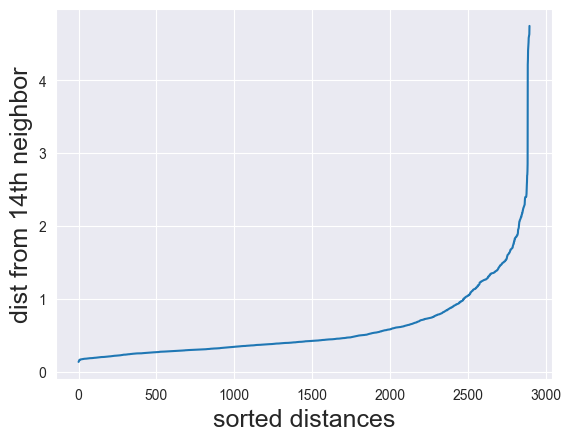

In [48]:
for dist, k in zip([dst_matrix_euclid_stages], ks):
    kth_distances = list()
    for d in dist:
        index_kth_distance = np.argsort(d)[k]
        kth_distances.append(d[index_kth_distance])

    plt.plot(range(0, len(kth_distances)), sorted(kth_distances))
    plt.ylabel("dist from %sth neighbor" % k, fontsize=18)
    plt.xlabel("sorted distances", fontsize=18)
    plt.show()

     eps  Clusters   Noise
0   0.80       2.0  2587.0
1   0.81       2.0  2583.0
2   0.82       3.0  2490.0
3   0.83       3.0  2484.0
4   0.84       3.0  2459.0
..   ...       ...     ...
65  1.45       4.0   983.0
66  1.46       4.0   953.0
67  1.47       4.0   942.0
68  1.48       4.0   925.0
69  1.49       4.0   917.0

[70 rows x 3 columns]


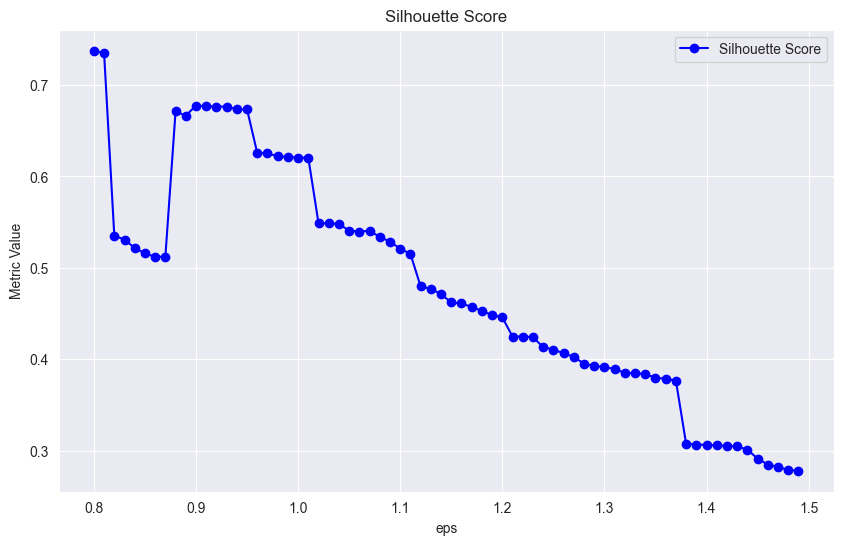

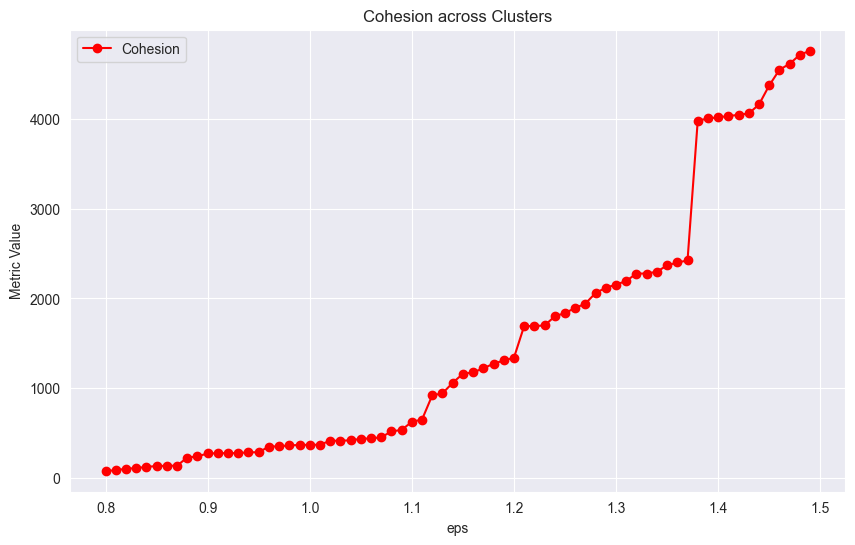

In [49]:
clustering.dbscan_tune(real_stages_df, dst_matrix_euclid_stages, np.arange(0.8, 1.5, 0.01))

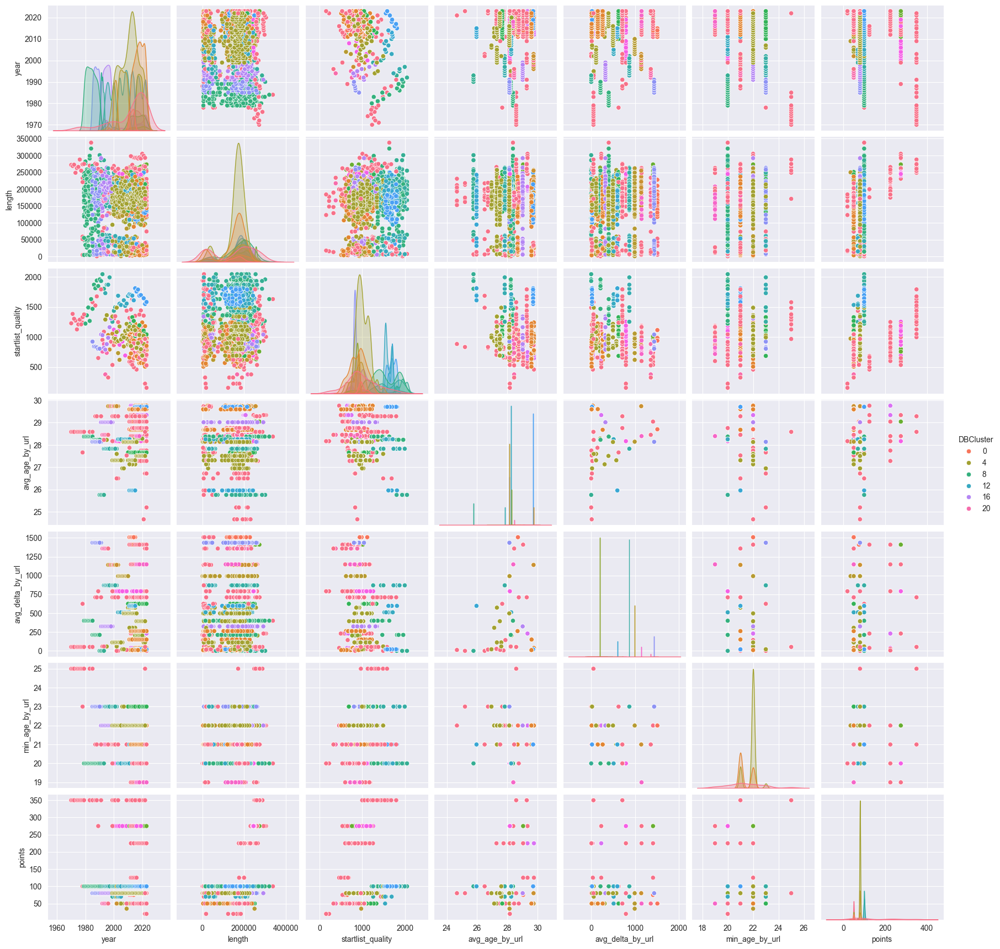

In [50]:
dbscan = DBSCAN(eps=1.1, min_samples=2*real_stages_df.shape[1], metric="precomputed", n_jobs=-1)
dbscan.fit_predict(dst_matrix_euclid_stages)
labels = dbscan.labels_

clustering.optimal_pair_plot(stages, 'DBCluster', labels)

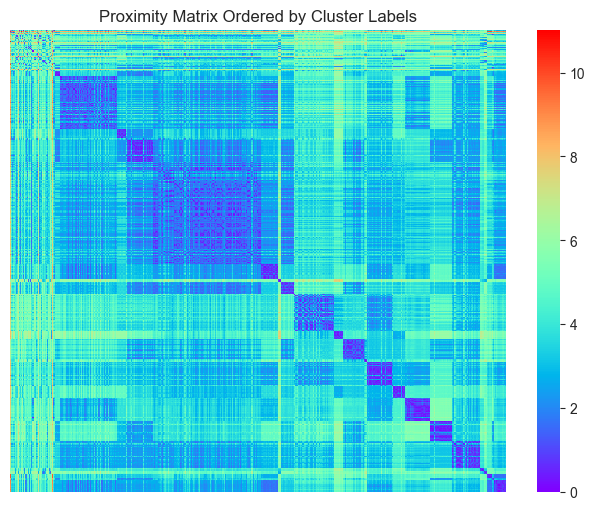

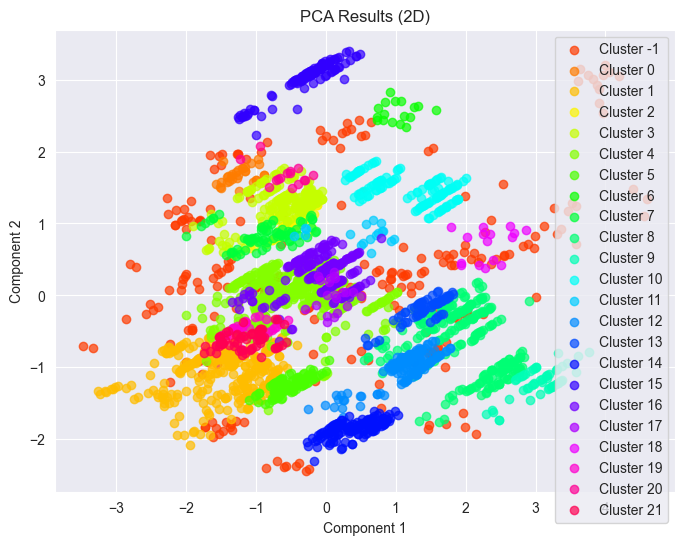

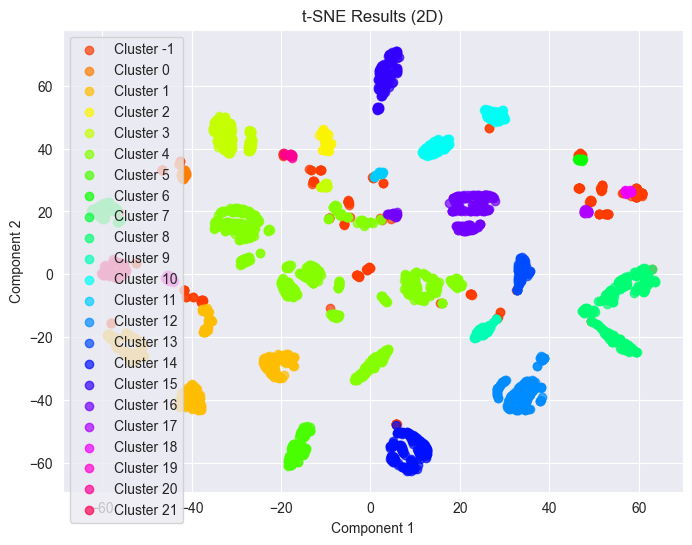

In [51]:
data_scaled = real_stages_df

clustering.similarity_matrix(real_stages_df, labels)
# 2D PCA
pca_2d = apply_pca(data_scaled, dimensions=2)
plot_results(pca_2d, labels, title="PCA Results (2D)", dimensions=2)

# 2D t-SNE
tsne_2d = apply_tsne(data_scaled, dimensions=2)
plot_results(tsne_2d, labels, title="t-SNE Results (2D)", dimensions=2)

### Optics
Tuning according to https://www.sefidian.com/2022/12/18/how-to-determine-epsilon-and-minpts-parameters-of-dbscan-clustering/#:~:text=A%20value%20of%20MinPts%20%3D%202,largest%20to%20the%20smallest%20value.

### Optics Cyclists

Hyperparameters tuning

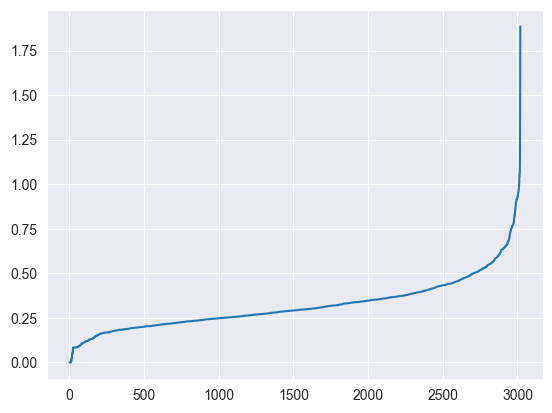

In [52]:
from sklearn.neighbors import NearestNeighbors
neighbors = NearestNeighbors(n_neighbors=real_cyclists_df.shape[1]*2)
neighbors_fit = neighbors.fit(real_cyclists_df)
distances, indices = neighbors_fit.kneighbors(real_cyclists_df)
distances = np.sort(distances, axis=0)
distances = distances[:,1]
plt.plot(distances)

C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\sklearn\cluster\_optics.py:661: UserWarning: All reachability values are inf. Set a larger max_eps or all data will be considered outliers.
  warnings.warn(
C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\sklearn\cluster\_optics.py:661: UserWarning: All reachability values are inf. Set a larger max_eps or all data will be considered outliers.
  warnings.warn(
C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\sklearn\cluster\_optics.py:661: UserWarning: All reachability values are inf. Set a larger max_eps or all data will be considered outliers.
  warnings.warn(
C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\sklearn\cluster\_optics.py:661: UserWarning: All reachability values are inf. Set a larger max_eps or all data will be considered outliers.
  warnings.warn(


Results for different eps values:
     eps  Clusters   Noise
0   0.25       0.0  3020.0
1   0.26       0.0  3020.0
2   0.27       0.0  3020.0
3   0.28       0.0  3020.0
4   0.29       1.0  3012.0
5   0.30       1.0  3011.0
6   0.31       1.0  3011.0
7   0.32       3.0  2981.0
8   0.33       6.0  2952.0
9   0.34       9.0  2903.0
10  0.35      14.0  2833.0
11  0.36      15.0  2746.0
12  0.37      13.0  2687.0
13  0.38      12.0  2860.0
14  0.39      14.0  2825.0
15  0.40      16.0  2849.0
16  0.41      11.0  2866.0
17  0.42       9.0  2904.0
18  0.43       9.0  2907.0
19  0.44      10.0  2920.0
20  0.45      10.0  2918.0
21  0.46      11.0  2904.0
22  0.47       9.0  2926.0
23  0.48       9.0  2925.0
24  0.49      11.0  2896.0
25  0.50       9.0  2926.0
26  0.51       8.0  2939.0
27  0.52       6.0  2961.0
28  0.53       7.0  2952.0
29  0.54       6.0  2961.0
30  0.55       8.0  2936.0
31  0.56       8.0  2936.0
32  0.57       8.0  2936.0
33  0.58       8.0  2936.0
34  0.59       8.0  2

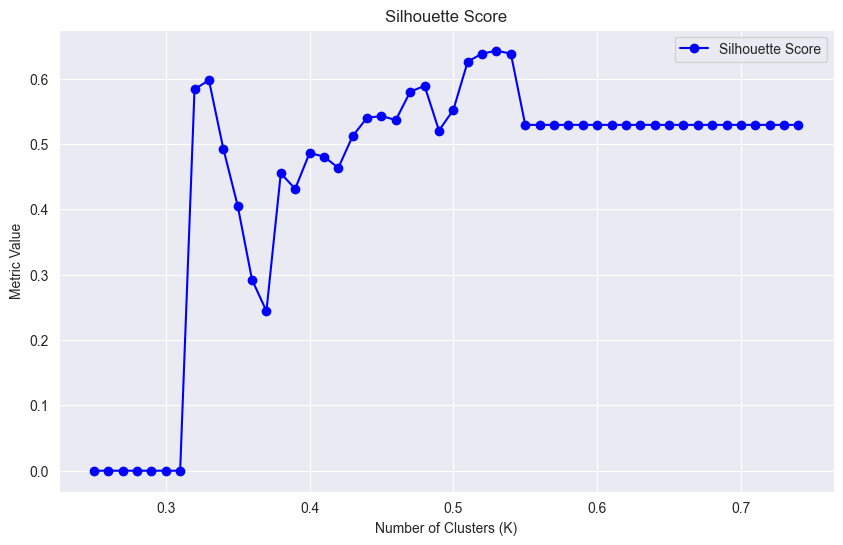

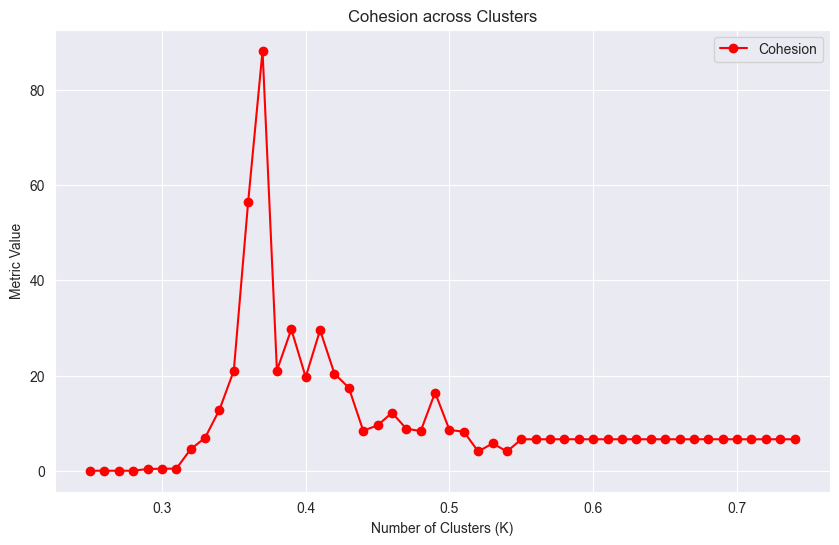

In [53]:
clustering.optics_tune(real_cyclists_df, np.arange(0.25, 0.75, 0.01))

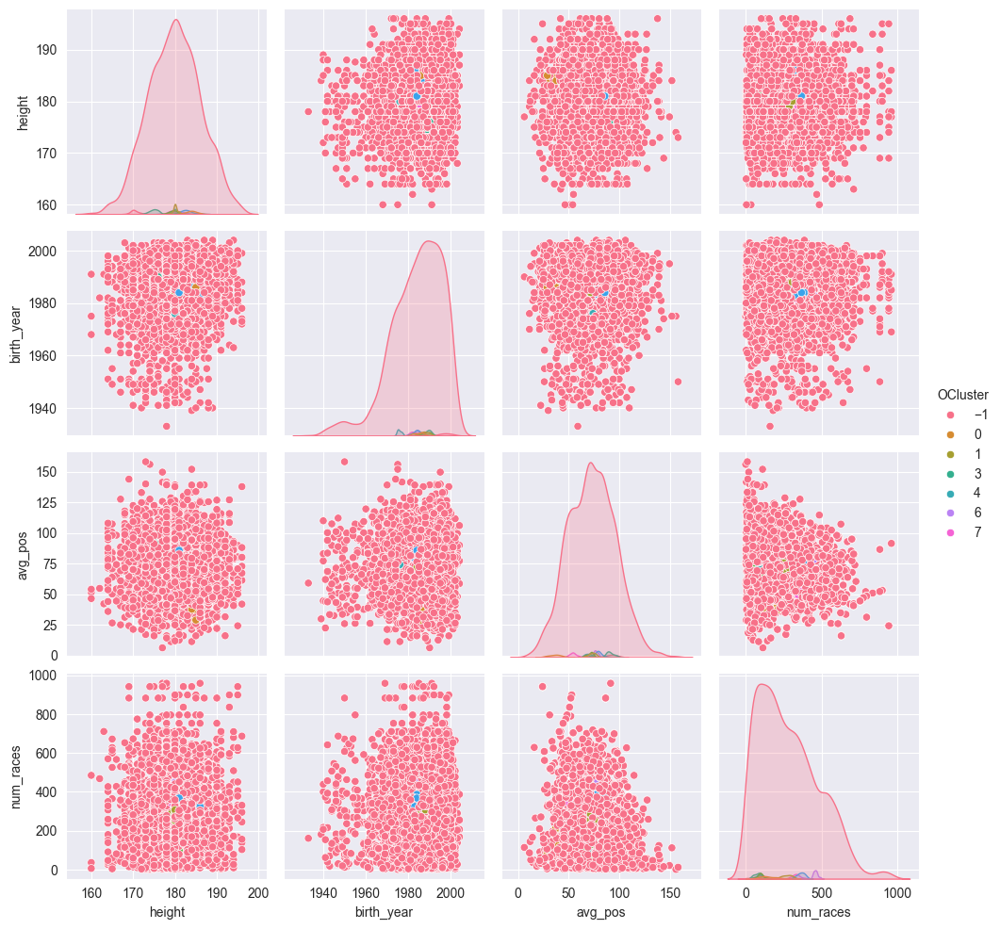

In [54]:
optics = OPTICS(max_eps=0.5, min_samples=2*real_cyclists_df.shape[1], metric='euclidean')
optics.fit(real_cyclists_df.values)

labels = optics.labels_
clustering.optimal_pair_plot(cyclists, 'OCluster', labels)

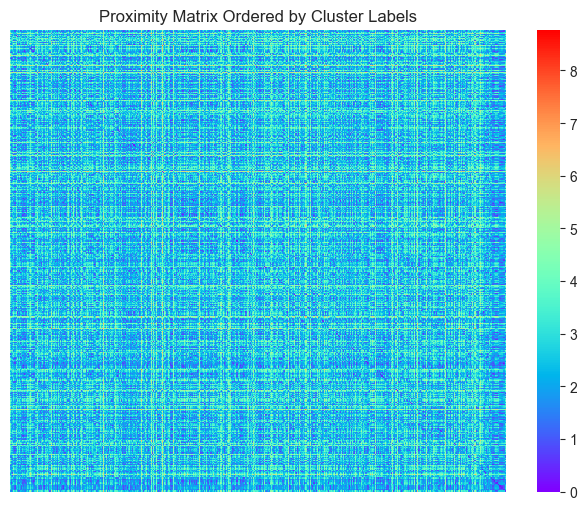

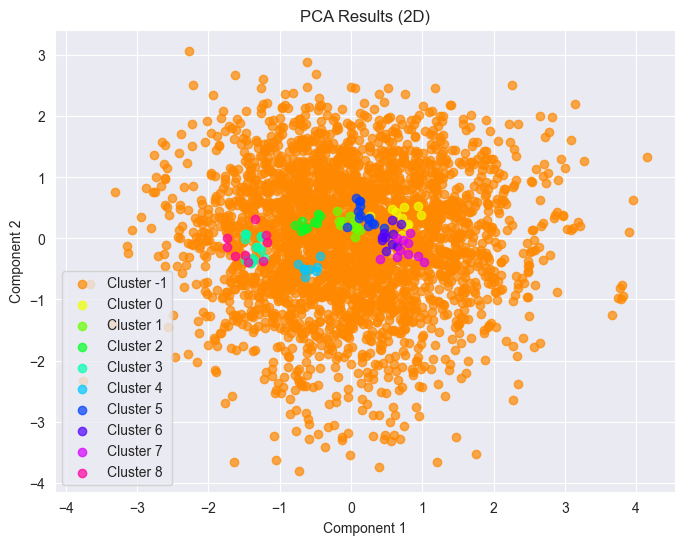

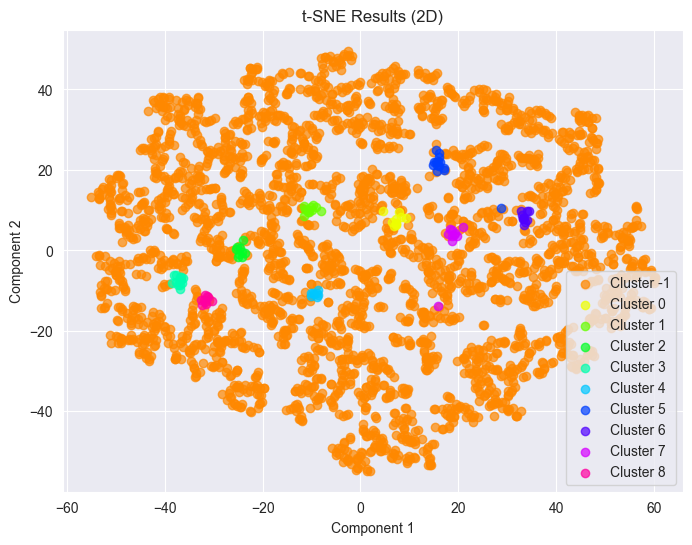

In [55]:
data_scaled = real_cyclists_df

clustering.similarity_matrix(real_cyclists_df, labels)
# 2D PCA
pca_2d = apply_pca(data_scaled, dimensions=2)
plot_results(pca_2d, labels, title="PCA Results (2D)", dimensions=2)

# 2D t-SNE
tsne_2d = apply_tsne(data_scaled, dimensions=2)
plot_results(tsne_2d, labels, title="t-SNE Results (2D)", dimensions=2)

### Optics Stages

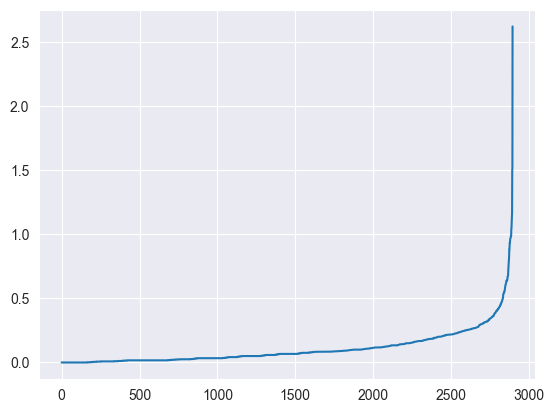

In [56]:
neighbors = NearestNeighbors(n_neighbors=real_stages_df.shape[1]*2)
neighbors_fit = neighbors.fit(real_stages_df)
distances, indices = neighbors_fit.kneighbors(real_stages_df)
distances = np.sort(distances, axis=0)
distances = distances[:,1]
plt.plot(distances)

Results for different eps values:
     eps  Clusters   Noise
0   0.20      12.0  2648.0
1   0.21      13.0  2609.0
2   0.22      16.0  2572.0
3   0.23      17.0  2513.0
4   0.24      18.0  2465.0
5   0.25      19.0  2437.0
6   0.26      22.0  2387.0
7   0.27      24.0  2312.0
8   0.28      27.0  2237.0
9   0.29      27.0  2192.0
10  0.30      27.0  2055.0
11  0.31      30.0  1977.0
12  0.32      29.0  1974.0
13  0.33      31.0  1943.0
14  0.34      31.0  1906.0
15  0.35      33.0  1955.0
16  0.36      35.0  1892.0
17  0.37      37.0  1853.0
18  0.38      36.0  1839.0
19  0.39      37.0  1825.0
20  0.40      39.0  1779.0
21  0.41      41.0  1734.0
22  0.42      40.0  1793.0
23  0.43      42.0  1755.0
24  0.44      41.0  1741.0
25  0.45      41.0  1737.0
26  0.46      41.0  1744.0
27  0.47      41.0  1743.0
28  0.48      41.0  1740.0
29  0.49      42.0  1724.0


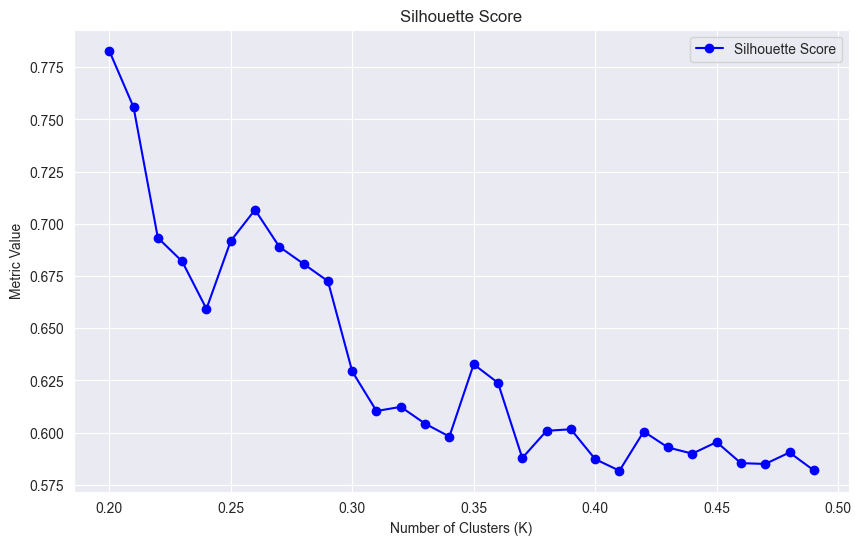

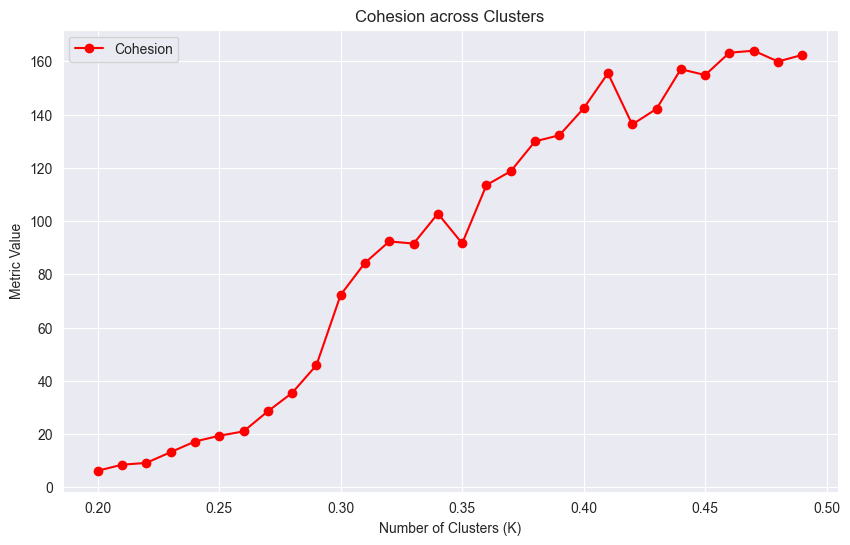

In [57]:
clustering.optics_tune(real_stages_df, np.arange(0.2, 0.5, 0.01))

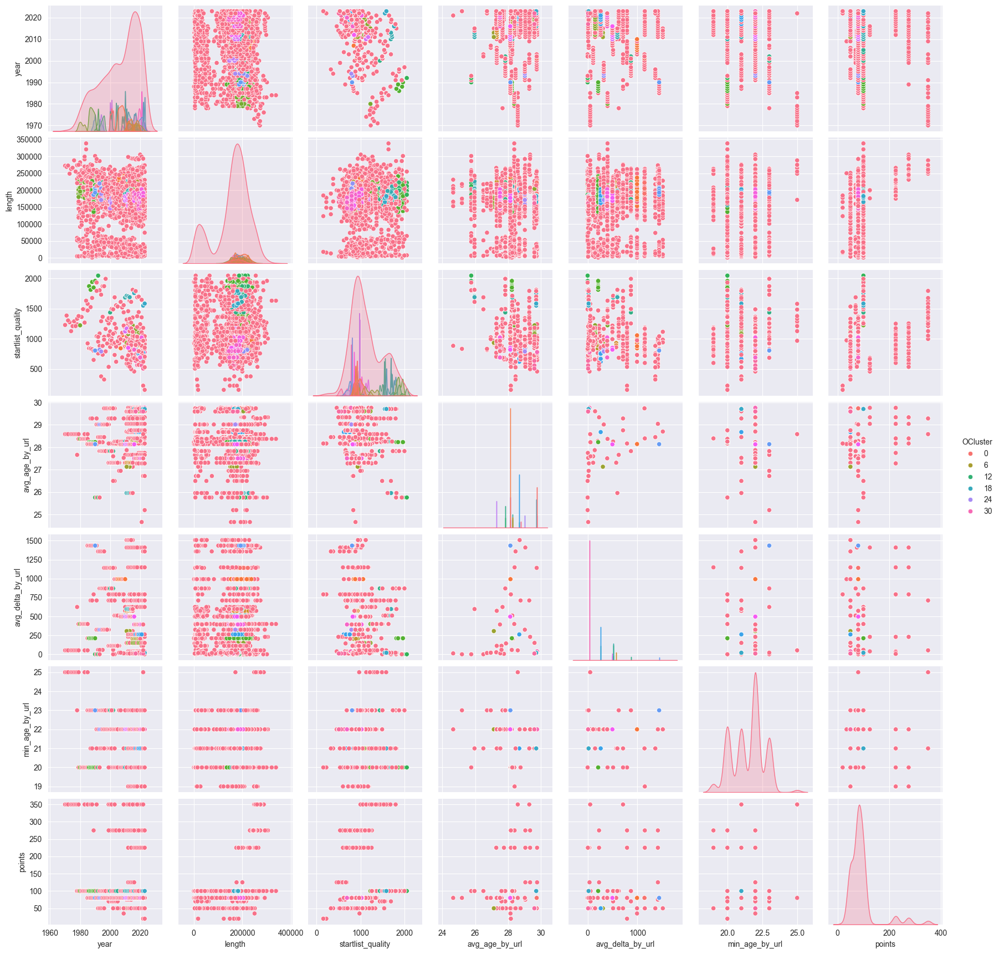

In [58]:
optics = OPTICS(max_eps=0.35, min_samples=2*real_stages_df.shape[1], metric='euclidean')
optics.fit(real_stages_df.values)

labels = optics.labels_
clustering.optimal_pair_plot(stages, 'OCluster', labels)

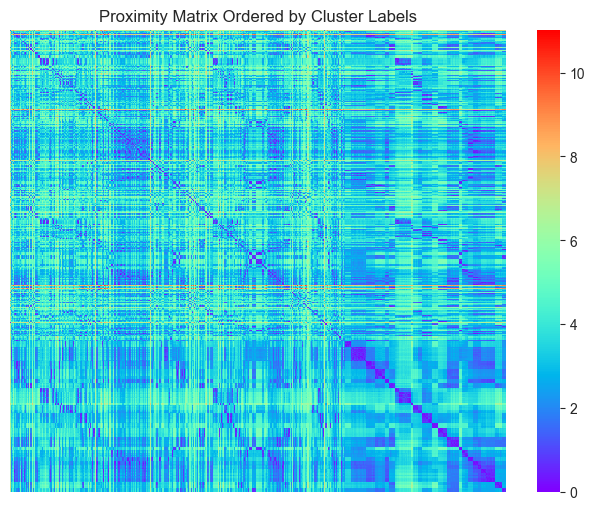

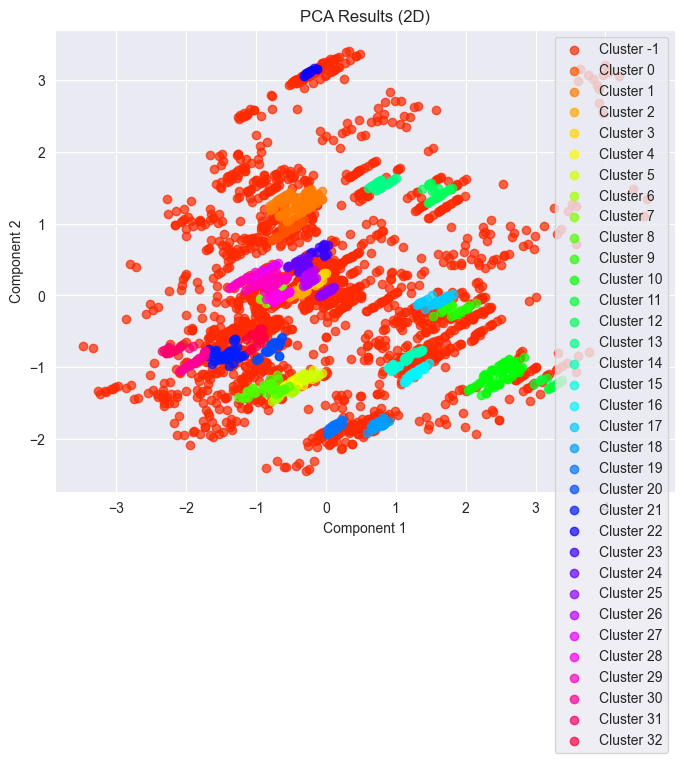

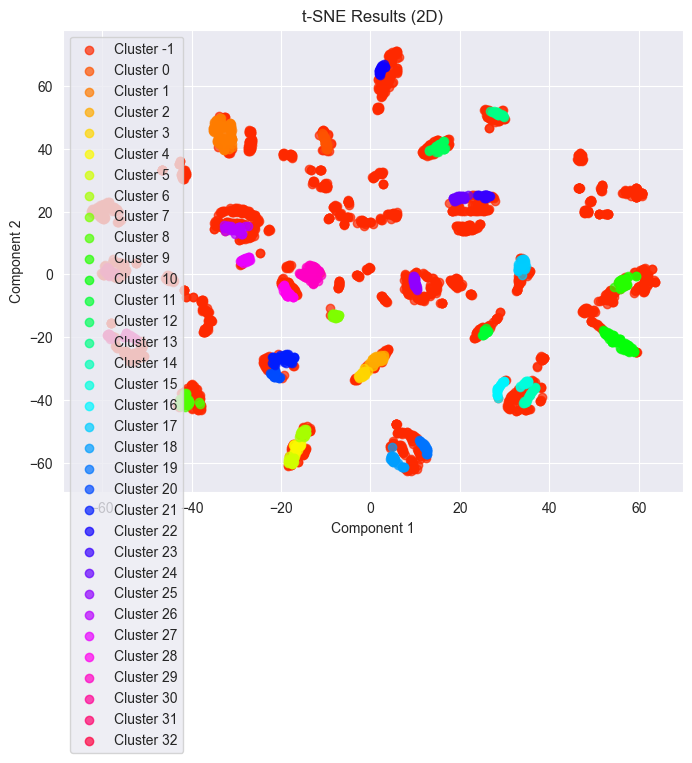

In [59]:
data_scaled = real_stages_df

clustering.similarity_matrix(real_stages_df, labels)
# 2D PCA
pca_2d = apply_pca(data_scaled, dimensions=2)
plot_results(pca_2d, labels, title="PCA Results (2D)", dimensions=2)

# 2D t-SNE
tsne_2d = apply_tsne(data_scaled, dimensions=2)
plot_results(tsne_2d, labels, title="t-SNE Results (2D)", dimensions=2)